In [269]:
import pandas as pd 
import numpy as np 
import plotly.express as px
from datetime import datetime
import datetime as dt
import unidecode

In [270]:
from urllib.request import urlopen
from unidecode import unidecode

In [271]:
import folium
from folium.plugins import MarkerCluster
import plotly.graph_objects as go

In [272]:
# Main Dataset
df = pd.read_csv("olist\dataset\oilist_cleaned_ahead_demo_dataset.csv")

In [273]:
df.shape

(119085, 40)

In [274]:
# Dataset that has the zip Code and Lat and Longitude
df_zip_cor = pd.read_csv("olist\dataset\other_datasets\olist_geolocation_dataset.csv")

In [275]:
df_zip_cor.columns

Index(['geolocation_zip_code_prefix', 'geolocation_lat', 'geolocation_lng',
       'geolocation_city', 'geolocation_state'],
      dtype='object')

In [276]:
df_zip_cor = df_zip_cor.drop_duplicates(subset = 'geolocation_zip_code_prefix')

In [277]:
list(df.columns)

['order_id',
 'payment_sequential',
 'payment_type',
 'payment_installments',
 'payment_value',
 'order_item_id',
 'product_id',
 'seller_id',
 'shipping_limit_date',
 'price',
 'freight_value',
 'customer_id',
 'order_status',
 'order_purchase_timestamp',
 'order_approved_at',
 'order_delivered_carrier_date',
 'order_delivered_customer_date',
 'order_estimated_delivery_date',
 'customer_unique_id',
 'customer_zip_code_prefix',
 'customer_city',
 'customer_state',
 'review_id',
 'review_score',
 'review_comment_title',
 'review_comment_message',
 'review_creation_date',
 'review_answer_timestamp',
 'product_category_name',
 'product_name_lenght',
 'product_description_lenght',
 'product_photos_qty',
 'product_weight_g',
 'product_length_cm',
 'product_height_cm',
 'product_width_cm',
 'product_category_name_english',
 'seller_zip_code_prefix',
 'seller_city',
 'seller_state']

### Joining Zip Codes For Buyers and Sellers

In [278]:
# Test
pd.merge(df, df_zip_cor[["geolocation_lat", "geolocation_lng", "geolocation_zip_code_prefix"]], how="left", left_on="customer_zip_code_prefix", right_on="geolocation_zip_code_prefix").rename({"geolocation_lat": "geolocation_lat_customer_zip", "geolocation_lng": "geolocation_lng_customer_zip"}).iloc[:,:-1]


,order_id,payment_sequential,payment_type,payment_installments,payment_value,order_item_id,product_id,seller_id,shipping_limit_date,price,...,product_weight_g,product_length_cm,product_height_cm,product_width_cm,product_category_name_english,seller_zip_code_prefix,seller_city,seller_state,geolocation_lat,geolocation_lng
0,00e7ee1b050b8499577073aeb2a297a1,1.0,credit_card,2.0,146.87,1.0,a9516a079e37a9c9c36b9b78b10169e8,7c67e1448b00f6e969d365cea6b010ab,2017-05-22T15:22:12.000Z,124.99,...,8683.0,54.0,64.0,31.0,office_furniture,8577.0,itaquaquecetuba,SP,-20.509897,-47.397866
1,29150127e6685892b6eab3eec79f59c7,1.0,credit_card,8.0,335.48,1.0,4aa6014eceb682077f9dc4bffebc05b0,b8bc237ba3788b23da09c0f1f3a3288c,2018-01-18T20:58:32.000Z,289.00,...,10150.0,89.0,15.0,40.0,housewares,88303.0,itajai,SC,-23.726853,-46.545746
2,b2059ed67ce144a36e2aa97d2c9e9ad2,1.0,credit_card,7.0,157.73,1.0,bd07b66896d6f1494f5b86251848ced7,7c67e1448b00f6e969d365cea6b010ab,2018-06-05T16:19:10.000Z,139.94,...,8267.0,52.0,52.0,17.0,office_furniture,8577.0,itaquaquecetuba,SP,-23.527788,-46.660310
3,951670f92359f4fe4a63112aa7306eba,1.0,credit_card,1.0,173.30,1.0,a5647c44af977b148e0a3a4751a09e2e,7c67e1448b00f6e969d365cea6b010ab,2018-03-27T16:31:16.000Z,149.94,...,12160.0,56.0,51.0,28.0,office_furniture,8577.0,itaquaquecetuba,SP,-23.496930,-46.185352
4,6b7d50bd145f6fc7f33cebabd7e49d0f,1.0,credit_card,8.0,252.25,1.0,9391a573abe00141c56e38d84d7d5b3b,4a3ca9315b744ce9f8e9374361493884,2018-07-31T10:10:09.000Z,230.00,...,5200.0,45.0,15.0,35.0,home_confort,14940.0,ibitinga,SP,-22.987222,-47.151073
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
119080,6760e20addcf0121e9d58f2f1ff14298,1.0,credit_card,6.0,88.78,1.0,ccb4503d9d43d245d3b295d0544f988b,527801b552d0077ffd170872eb49683b,2018-04-12T16:08:45.000Z,74.90,...,611.0,22.0,22.0,23.0,books_general_interest,17400.0,garca,SP,-23.587901,-46.501830
119081,9ec0c8947d973db4f4e8dcf1fbfa8f1b,1.0,credit_card,3.0,129.06,1.0,9ede6b0570a75a4b9de4f383329f99ee,3fd1e727ba94cfe122d165e176ce7967,2018-04-10T08:35:12.000Z,114.90,...,1211.0,25.0,24.0,22.0,sports_leisure,14802.0,araraquara,SP,-23.612294,-46.765787
119082,fed4434add09a6f332ea398efd656a5c,1.0,credit_card,5.0,56.04,1.0,7a5d2e1e131a860ae7d18f6fffa9d689,d9e7e7778b32987280a6f2cb9a39c57d,2018-04-12T20:30:03.000Z,37.00,...,870.0,25.0,20.0,18.0,health_beauty,3304.0,sao paulo,SP,-3.744128,-38.510859
119083,e31ec91cea1ecf97797787471f98a8c2,1.0,credit_card,2.0,711.07,1.0,f819f0c84a64f02d3a5606ca95edd272,4869f7a5dfa277a7dca6462dcf3b52b2,2017-11-09T21:15:51.000Z,689.00,...,710.0,19.0,13.0,14.0,watches_gifts,14840.0,guariba,SP,-29.956391,-51.167614


In [279]:
test_df = pd.merge(df, df_zip_cor[["geolocation_lat", "geolocation_lng", "geolocation_zip_code_prefix"]], how="left", left_on="customer_zip_code_prefix", right_on="geolocation_zip_code_prefix").iloc[:,:-1]
test_df.rename({"geolocation_lat": "geolocation_lat_customer_zip", "geolocation_lng": "geolocation_lng_customer_zip"}, axis = 1, inplace = True)
test_df.head()

,order_id,payment_sequential,payment_type,payment_installments,payment_value,order_item_id,product_id,seller_id,shipping_limit_date,price,...,product_weight_g,product_length_cm,product_height_cm,product_width_cm,product_category_name_english,seller_zip_code_prefix,seller_city,seller_state,geolocation_lat_customer_zip,geolocation_lng_customer_zip
0,00e7ee1b050b8499577073aeb2a297a1,1.0,credit_card,2.0,146.87,1.0,a9516a079e37a9c9c36b9b78b10169e8,7c67e1448b00f6e969d365cea6b010ab,2017-05-22T15:22:12.000Z,124.99,...,8683.0,54.0,64.0,31.0,office_furniture,8577.0,itaquaquecetuba,SP,-20.509897,-47.397866
1,29150127e6685892b6eab3eec79f59c7,1.0,credit_card,8.0,335.48,1.0,4aa6014eceb682077f9dc4bffebc05b0,b8bc237ba3788b23da09c0f1f3a3288c,2018-01-18T20:58:32.000Z,289.00,...,10150.0,89.0,15.0,40.0,housewares,88303.0,itajai,SC,-23.726853,-46.545746
2,b2059ed67ce144a36e2aa97d2c9e9ad2,1.0,credit_card,7.0,157.73,1.0,bd07b66896d6f1494f5b86251848ced7,7c67e1448b00f6e969d365cea6b010ab,2018-06-05T16:19:10.000Z,139.94,...,8267.0,52.0,52.0,17.0,office_furniture,8577.0,itaquaquecetuba,SP,-23.527788,-46.660310
3,951670f92359f4fe4a63112aa7306eba,1.0,credit_card,1.0,173.30,1.0,a5647c44af977b148e0a3a4751a09e2e,7c67e1448b00f6e969d365cea6b010ab,2018-03-27T16:31:16.000Z,149.94,...,12160.0,56.0,51.0,28.0,office_furniture,8577.0,itaquaquecetuba,SP,-23.496930,-46.185352
4,6b7d50bd145f6fc7f33cebabd7e49d0f,1.0,credit_card,8.0,252.25,1.0,9391a573abe00141c56e38d84d7d5b3b,4a3ca9315b744ce9f8e9374361493884,2018-07-31T10:10:09.000Z,230.00,...,5200.0,45.0,15.0,35.0,home_confort,14940.0,ibitinga,SP,-22.987222,-47.151073


In [280]:
# Sellers Test 
test_df = pd.merge(df, df_zip_cor[["geolocation_lat", "geolocation_lng", "geolocation_zip_code_prefix"]], how="left", left_on="seller_zip_code_prefix", right_on="geolocation_zip_code_prefix").iloc[:,:-1]
test_df.rename({"geolocation_lat": "geolocation_lat_seller_zip", "geolocation_lng": "geolocation_lng_seller_zip"}, axis = 1, inplace = True)
test_df.head()

,order_id,payment_sequential,payment_type,payment_installments,payment_value,order_item_id,product_id,seller_id,shipping_limit_date,price,...,product_weight_g,product_length_cm,product_height_cm,product_width_cm,product_category_name_english,seller_zip_code_prefix,seller_city,seller_state,geolocation_lat_seller_zip,geolocation_lng_seller_zip
0,00e7ee1b050b8499577073aeb2a297a1,1.0,credit_card,2.0,146.87,1.0,a9516a079e37a9c9c36b9b78b10169e8,7c67e1448b00f6e969d365cea6b010ab,2017-05-22T15:22:12.000Z,124.99,...,8683.0,54.0,64.0,31.0,office_furniture,8577.0,itaquaquecetuba,SP,-23.482623,-46.374490
1,29150127e6685892b6eab3eec79f59c7,1.0,credit_card,8.0,335.48,1.0,4aa6014eceb682077f9dc4bffebc05b0,b8bc237ba3788b23da09c0f1f3a3288c,2018-01-18T20:58:32.000Z,289.00,...,10150.0,89.0,15.0,40.0,housewares,88303.0,itajai,SC,-26.912429,-48.677381
2,b2059ed67ce144a36e2aa97d2c9e9ad2,1.0,credit_card,7.0,157.73,1.0,bd07b66896d6f1494f5b86251848ced7,7c67e1448b00f6e969d365cea6b010ab,2018-06-05T16:19:10.000Z,139.94,...,8267.0,52.0,52.0,17.0,office_furniture,8577.0,itaquaquecetuba,SP,-23.482623,-46.374490
3,951670f92359f4fe4a63112aa7306eba,1.0,credit_card,1.0,173.30,1.0,a5647c44af977b148e0a3a4751a09e2e,7c67e1448b00f6e969d365cea6b010ab,2018-03-27T16:31:16.000Z,149.94,...,12160.0,56.0,51.0,28.0,office_furniture,8577.0,itaquaquecetuba,SP,-23.482623,-46.374490
4,6b7d50bd145f6fc7f33cebabd7e49d0f,1.0,credit_card,8.0,252.25,1.0,9391a573abe00141c56e38d84d7d5b3b,4a3ca9315b744ce9f8e9374361493884,2018-07-31T10:10:09.000Z,230.00,...,5200.0,45.0,15.0,35.0,home_confort,14940.0,ibitinga,SP,-21.766477,-48.831547


In [281]:
def zip_cord(side_of_transaction, df = df, df_zip_cor = df_zip_cor):
    
    """Zip codes come with coordinate points. The duplicate zip codes were dropped previously yo make every zip code unique. 
    
    The buyer and seller each have a zip code in the main dataframe. The zip dataframe has zip codes with coordinates. Two different joins are needed in order to get the coordinates for buyers and sellers. 
    
    Therefore two joins need to happen seperately. One to get the buyer zip coordinates and another onw for the seller's. To accomplish this we use a function to dictate whether or not we are joining the buyer or the seller. 
    
    Then after this we can join accordingly. The redundant column 'geolocation_zip_code_prefix' is dropped. Then we can call the function specify buyer or seller and return the dataframe that we need.
    
    The function can be called twice once for the buyer and once for the seller to accomplish the task. The two new columns are of course renamed to specify who it pertains to (the buyer or seller).
    """
    # Must make the outside variables available inside the function by assigning them.
   
    
    
#     if side_of_transaction == "customers":
#         df = pd.merge(df, df_zip_cor[["geolocation_lat", "geolocation_lng", "geolocation_zip_code_prefix"]], how="left", left_on="customer_zip_code_prefix", right_on="geolocation_zip_code_prefix").iloc[:,:-1]
#         df.rename({"geolocation_lat": "geolocation_lat_customer_zip", "geolocation_lng": "geolocation_lng_customer_zip"}, axis = 1, inplace = True)
#         return df 
    
#     if side_of_transaction == "sellers":
#         df = pd.merge(df, df_zip_cor[["geolocation_lat", "geolocation_lng", "geolocation_zip_code_prefix"]], how="left", left_on="seller_zip_code_prefix", right_on="geolocation_zip_code_prefix").iloc[:,:-1]
#         df.rename({"geolocation_lat": "geolocation_lat_seller_zip", "geolocation_lng": "geolocation_lng_seller_zip"}, axis = 1, inplace = True)
#         return df
        
    
        
        

### Modifying DF #1 Adding Coordinates for Buyer and Seller Zip Codes
For some reason the process did not work by calling a function. Copying and pasting into seperate cells did though. 

In [282]:
# Importing the dataset to prevent the possibility of calling the function multiple times possibly ruining the dataset
df = pd.read_csv("olist\dataset\oilist_cleaned_ahead_demo_dataset.csv")

In [283]:
df = pd.merge(df, df_zip_cor[["geolocation_lat", "geolocation_lng", "geolocation_zip_code_prefix"]], how="left", left_on="customer_zip_code_prefix", right_on="geolocation_zip_code_prefix").iloc[:,:-1]
df.rename({"geolocation_lat": "geolocation_lat_customer_zip", "geolocation_lng": "geolocation_lng_customer_zip"}, axis = 1, inplace = True)



In [284]:
df = pd.merge(df, df_zip_cor[["geolocation_lat", "geolocation_lng", "geolocation_zip_code_prefix"]], how="left", left_on="seller_zip_code_prefix", right_on="geolocation_zip_code_prefix").iloc[:,:-1]
df.rename({"geolocation_lat": "geolocation_lat_seller_zip", "geolocation_lng": "geolocation_lng_seller_zip"}, axis = 1, inplace = True)

In [285]:
df.head()

,order_id,payment_sequential,payment_type,payment_installments,payment_value,order_item_id,product_id,seller_id,shipping_limit_date,price,...,product_height_cm,product_width_cm,product_category_name_english,seller_zip_code_prefix,seller_city,seller_state,geolocation_lat_customer_zip,geolocation_lng_customer_zip,geolocation_lat_seller_zip,geolocation_lng_seller_zip
0,00e7ee1b050b8499577073aeb2a297a1,1.0,credit_card,2.0,146.87,1.0,a9516a079e37a9c9c36b9b78b10169e8,7c67e1448b00f6e969d365cea6b010ab,2017-05-22T15:22:12.000Z,124.99,...,64.0,31.0,office_furniture,8577.0,itaquaquecetuba,SP,-20.509897,-47.397866,-23.482623,-46.374490
1,29150127e6685892b6eab3eec79f59c7,1.0,credit_card,8.0,335.48,1.0,4aa6014eceb682077f9dc4bffebc05b0,b8bc237ba3788b23da09c0f1f3a3288c,2018-01-18T20:58:32.000Z,289.00,...,15.0,40.0,housewares,88303.0,itajai,SC,-23.726853,-46.545746,-26.912429,-48.677381
2,b2059ed67ce144a36e2aa97d2c9e9ad2,1.0,credit_card,7.0,157.73,1.0,bd07b66896d6f1494f5b86251848ced7,7c67e1448b00f6e969d365cea6b010ab,2018-06-05T16:19:10.000Z,139.94,...,52.0,17.0,office_furniture,8577.0,itaquaquecetuba,SP,-23.527788,-46.660310,-23.482623,-46.374490
3,951670f92359f4fe4a63112aa7306eba,1.0,credit_card,1.0,173.30,1.0,a5647c44af977b148e0a3a4751a09e2e,7c67e1448b00f6e969d365cea6b010ab,2018-03-27T16:31:16.000Z,149.94,...,51.0,28.0,office_furniture,8577.0,itaquaquecetuba,SP,-23.496930,-46.185352,-23.482623,-46.374490
4,6b7d50bd145f6fc7f33cebabd7e49d0f,1.0,credit_card,8.0,252.25,1.0,9391a573abe00141c56e38d84d7d5b3b,4a3ca9315b744ce9f8e9374361493884,2018-07-31T10:10:09.000Z,230.00,...,15.0,35.0,home_confort,14940.0,ibitinga,SP,-22.987222,-47.151073,-21.766477,-48.831547


In [286]:
# Safe Keeping for Successfully Done Zip Code Merge 
df_zip_merged = df

## Getting Full State Names

In [287]:
# Web Scraping State Data 
url = "https://brazil-help.com/brazilian_states.htm"
state_scrape = pd.read_html(url)
state_scrape = state_scrape[2]
state_scrape = state_scrape.iloc[1::,:]
state_scrape.head()

,0,1,2,3,4,5,6,7,8,9
1,Common Two Letter Abbreviation,State,Capitol City,Region,Size (in km²),Population (2007 estimate),% Pop. Urban/Rural,Number of Municipal Districts,Per Capita GNP in Reais (R$),Life Expectancy (2007 projection)
2,AC,Acre,Rio Branco,North,152581,664000,69.6/30.4,24,"R$5,413",71.1
3,AL,Alagoas,Maceió,Northeast,27767,3557000,67.4/32.6,102,"R$3,876",65.4
4,AP,Amapá,Macapá,North,142814,619000,93.7/6.3,16,"R$6,796",70.1
5,AM,Amazonas,Manaus,North,1570745,3351000,77.6/22.4,62,"R$11,434",71.3


In [288]:
state_info = pd.read_csv(r"olist\dataset\other_datasets\brazil_state.csv")

In [289]:
df.columns

Index(['order_id', 'payment_sequential', 'payment_type',
       'payment_installments', 'payment_value', 'order_item_id', 'product_id',
       'seller_id', 'shipping_limit_date', 'price', 'freight_value',
       'customer_id', 'order_status', 'order_purchase_timestamp',
       'order_approved_at', 'order_delivered_carrier_date',
       'order_delivered_customer_date', 'order_estimated_delivery_date',
       'customer_unique_id', 'customer_zip_code_prefix', 'customer_city',
       'customer_state', 'review_id', 'review_score', 'review_comment_title',
       'review_comment_message', 'review_creation_date',
       'review_answer_timestamp', 'product_category_name',
       'product_name_lenght', 'product_description_lenght',
       'product_photos_qty', 'product_weight_g', 'product_length_cm',
       'product_height_cm', 'product_width_cm',
       'product_category_name_english', 'seller_zip_code_prefix',
       'seller_city', 'seller_state', 'geolocation_lat_customer_zip',
       'geoloc

In [290]:
df.shape

(119085, 44)

In [291]:
# Merge Test 
pd.merge(df, state_info[["State", "Region", "Common Two Letter Abbreviation"]], left_on = "seller_state", right_on = "Common Two Letter Abbreviation", how = "left")  #.rename(columns = {df.columns[-2]: "Region_Seller"})

,order_id,payment_sequential,payment_type,payment_installments,payment_value,order_item_id,product_id,seller_id,shipping_limit_date,price,...,seller_zip_code_prefix,seller_city,seller_state,geolocation_lat_customer_zip,geolocation_lng_customer_zip,geolocation_lat_seller_zip,geolocation_lng_seller_zip,State,Region,Common Two Letter Abbreviation
0,00e7ee1b050b8499577073aeb2a297a1,1.0,credit_card,2.0,146.87,1.0,a9516a079e37a9c9c36b9b78b10169e8,7c67e1448b00f6e969d365cea6b010ab,2017-05-22T15:22:12.000Z,124.99,...,8577.0,itaquaquecetuba,SP,-20.509897,-47.397866,-23.482623,-46.374490,São Paulo,Southeast,SP
1,29150127e6685892b6eab3eec79f59c7,1.0,credit_card,8.0,335.48,1.0,4aa6014eceb682077f9dc4bffebc05b0,b8bc237ba3788b23da09c0f1f3a3288c,2018-01-18T20:58:32.000Z,289.00,...,88303.0,itajai,SC,-23.726853,-46.545746,-26.912429,-48.677381,Santa Catarina,South,SC
2,b2059ed67ce144a36e2aa97d2c9e9ad2,1.0,credit_card,7.0,157.73,1.0,bd07b66896d6f1494f5b86251848ced7,7c67e1448b00f6e969d365cea6b010ab,2018-06-05T16:19:10.000Z,139.94,...,8577.0,itaquaquecetuba,SP,-23.527788,-46.660310,-23.482623,-46.374490,São Paulo,Southeast,SP
3,951670f92359f4fe4a63112aa7306eba,1.0,credit_card,1.0,173.30,1.0,a5647c44af977b148e0a3a4751a09e2e,7c67e1448b00f6e969d365cea6b010ab,2018-03-27T16:31:16.000Z,149.94,...,8577.0,itaquaquecetuba,SP,-23.496930,-46.185352,-23.482623,-46.374490,São Paulo,Southeast,SP
4,6b7d50bd145f6fc7f33cebabd7e49d0f,1.0,credit_card,8.0,252.25,1.0,9391a573abe00141c56e38d84d7d5b3b,4a3ca9315b744ce9f8e9374361493884,2018-07-31T10:10:09.000Z,230.00,...,14940.0,ibitinga,SP,-22.987222,-47.151073,-21.766477,-48.831547,São Paulo,Southeast,SP
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
119080,6760e20addcf0121e9d58f2f1ff14298,1.0,credit_card,6.0,88.78,1.0,ccb4503d9d43d245d3b295d0544f988b,527801b552d0077ffd170872eb49683b,2018-04-12T16:08:45.000Z,74.90,...,17400.0,garca,SP,-23.587901,-46.501830,-22.218989,-49.643623,São Paulo,Southeast,SP
119081,9ec0c8947d973db4f4e8dcf1fbfa8f1b,1.0,credit_card,3.0,129.06,1.0,9ede6b0570a75a4b9de4f383329f99ee,3fd1e727ba94cfe122d165e176ce7967,2018-04-10T08:35:12.000Z,114.90,...,14802.0,araraquara,SP,-23.612294,-46.765787,-21.760806,-48.172285,São Paulo,Southeast,SP
119082,fed4434add09a6f332ea398efd656a5c,1.0,credit_card,5.0,56.04,1.0,7a5d2e1e131a860ae7d18f6fffa9d689,d9e7e7778b32987280a6f2cb9a39c57d,2018-04-12T20:30:03.000Z,37.00,...,3304.0,sao paulo,SP,-3.744128,-38.510859,-23.544897,-46.577772,São Paulo,Southeast,SP
119083,e31ec91cea1ecf97797787471f98a8c2,1.0,credit_card,2.0,711.07,1.0,f819f0c84a64f02d3a5606ca95edd272,4869f7a5dfa277a7dca6462dcf3b52b2,2017-11-09T21:15:51.000Z,689.00,...,14840.0,guariba,SP,-29.956391,-51.167614,-21.362358,-48.232976,São Paulo,Southeast,SP


In [292]:
# Seller Test
df_region_state_test = pd.merge(df_region_state_test, state_info[["State", "Region", "Common Two Letter Abbreviation"]], left_on = "seller_state", right_on = "Common Two Letter Abbreviation", how = "left").iloc[:, :-1]
df_region_state_test = df_region_state_test.rename(columns = {df_region_state_test.columns[-1]: "Region_Seller", df_region_state_test.columns[-2]: "State_Seller"})

NameError: name 'df_region_state_test' is not defined

In [293]:
df_region_state_test.head()

NameError: name 'df_region_state_test' is not defined

In [294]:
# Note that for these tests there are 46 instead of 48 columns because the subsequent test takes the regular df as an input and not the last test.

In [295]:
# Customer Test
df_region_state_test = pd.merge(df_region_state_test, state_info[["State", "Region", "Common Two Letter Abbreviation"]], left_on = "customer_state", right_on = "Common Two Letter Abbreviation", how = "left").iloc[:, :-1]
df_region_state_test = df_region_state_test.rename(columns = {df_region_state_test.columns[-1]: "Region_Customer", df_region_state_test.columns[-2]: "State_Customer"})

NameError: name 'df_region_state_test' is not defined

In [296]:
df_region_state_test.head()

NameError: name 'df_region_state_test' is not defined

## Modification DF #2 Adding Customer State and Region 

In [297]:
# Seller
df = pd.merge(df, state_info[["State", "Region", "Common Two Letter Abbreviation"]], left_on = "seller_state", right_on = "Common Two Letter Abbreviation", how = "left").iloc[:, :-1]
df = df.rename(columns = {df.columns[-1]: "Region_Seller", df.columns[-2]: "State_Seller"})

In [298]:
#df.head()
df

,order_id,payment_sequential,payment_type,payment_installments,payment_value,order_item_id,product_id,seller_id,shipping_limit_date,price,...,product_category_name_english,seller_zip_code_prefix,seller_city,seller_state,geolocation_lat_customer_zip,geolocation_lng_customer_zip,geolocation_lat_seller_zip,geolocation_lng_seller_zip,State_Seller,Region_Seller
0,00e7ee1b050b8499577073aeb2a297a1,1.0,credit_card,2.0,146.87,1.0,a9516a079e37a9c9c36b9b78b10169e8,7c67e1448b00f6e969d365cea6b010ab,2017-05-22T15:22:12.000Z,124.99,...,office_furniture,8577.0,itaquaquecetuba,SP,-20.509897,-47.397866,-23.482623,-46.374490,São Paulo,Southeast
1,29150127e6685892b6eab3eec79f59c7,1.0,credit_card,8.0,335.48,1.0,4aa6014eceb682077f9dc4bffebc05b0,b8bc237ba3788b23da09c0f1f3a3288c,2018-01-18T20:58:32.000Z,289.00,...,housewares,88303.0,itajai,SC,-23.726853,-46.545746,-26.912429,-48.677381,Santa Catarina,South
2,b2059ed67ce144a36e2aa97d2c9e9ad2,1.0,credit_card,7.0,157.73,1.0,bd07b66896d6f1494f5b86251848ced7,7c67e1448b00f6e969d365cea6b010ab,2018-06-05T16:19:10.000Z,139.94,...,office_furniture,8577.0,itaquaquecetuba,SP,-23.527788,-46.660310,-23.482623,-46.374490,São Paulo,Southeast
3,951670f92359f4fe4a63112aa7306eba,1.0,credit_card,1.0,173.30,1.0,a5647c44af977b148e0a3a4751a09e2e,7c67e1448b00f6e969d365cea6b010ab,2018-03-27T16:31:16.000Z,149.94,...,office_furniture,8577.0,itaquaquecetuba,SP,-23.496930,-46.185352,-23.482623,-46.374490,São Paulo,Southeast
4,6b7d50bd145f6fc7f33cebabd7e49d0f,1.0,credit_card,8.0,252.25,1.0,9391a573abe00141c56e38d84d7d5b3b,4a3ca9315b744ce9f8e9374361493884,2018-07-31T10:10:09.000Z,230.00,...,home_confort,14940.0,ibitinga,SP,-22.987222,-47.151073,-21.766477,-48.831547,São Paulo,Southeast
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
119080,6760e20addcf0121e9d58f2f1ff14298,1.0,credit_card,6.0,88.78,1.0,ccb4503d9d43d245d3b295d0544f988b,527801b552d0077ffd170872eb49683b,2018-04-12T16:08:45.000Z,74.90,...,books_general_interest,17400.0,garca,SP,-23.587901,-46.501830,-22.218989,-49.643623,São Paulo,Southeast
119081,9ec0c8947d973db4f4e8dcf1fbfa8f1b,1.0,credit_card,3.0,129.06,1.0,9ede6b0570a75a4b9de4f383329f99ee,3fd1e727ba94cfe122d165e176ce7967,2018-04-10T08:35:12.000Z,114.90,...,sports_leisure,14802.0,araraquara,SP,-23.612294,-46.765787,-21.760806,-48.172285,São Paulo,Southeast
119082,fed4434add09a6f332ea398efd656a5c,1.0,credit_card,5.0,56.04,1.0,7a5d2e1e131a860ae7d18f6fffa9d689,d9e7e7778b32987280a6f2cb9a39c57d,2018-04-12T20:30:03.000Z,37.00,...,health_beauty,3304.0,sao paulo,SP,-3.744128,-38.510859,-23.544897,-46.577772,São Paulo,Southeast
119083,e31ec91cea1ecf97797787471f98a8c2,1.0,credit_card,2.0,711.07,1.0,f819f0c84a64f02d3a5606ca95edd272,4869f7a5dfa277a7dca6462dcf3b52b2,2017-11-09T21:15:51.000Z,689.00,...,watches_gifts,14840.0,guariba,SP,-29.956391,-51.167614,-21.362358,-48.232976,São Paulo,Southeast


In [299]:
# Customer 
df = pd.merge(df, state_info[["State", "Region", "Common Two Letter Abbreviation"]], left_on = "customer_state", right_on = "Common Two Letter Abbreviation", how = "left").iloc[:, :-1]
df = df.rename(columns = {df.columns[-1]: "Region_Customer", df.columns[-2]: "State_Customer"})

In [300]:
#df.head()
df

,order_id,payment_sequential,payment_type,payment_installments,payment_value,order_item_id,product_id,seller_id,shipping_limit_date,price,...,seller_city,seller_state,geolocation_lat_customer_zip,geolocation_lng_customer_zip,geolocation_lat_seller_zip,geolocation_lng_seller_zip,State_Seller,Region_Seller,State_Customer,Region_Customer
0,00e7ee1b050b8499577073aeb2a297a1,1.0,credit_card,2.0,146.87,1.0,a9516a079e37a9c9c36b9b78b10169e8,7c67e1448b00f6e969d365cea6b010ab,2017-05-22T15:22:12.000Z,124.99,...,itaquaquecetuba,SP,-20.509897,-47.397866,-23.482623,-46.374490,São Paulo,Southeast,São Paulo,Southeast
1,29150127e6685892b6eab3eec79f59c7,1.0,credit_card,8.0,335.48,1.0,4aa6014eceb682077f9dc4bffebc05b0,b8bc237ba3788b23da09c0f1f3a3288c,2018-01-18T20:58:32.000Z,289.00,...,itajai,SC,-23.726853,-46.545746,-26.912429,-48.677381,Santa Catarina,South,São Paulo,Southeast
2,b2059ed67ce144a36e2aa97d2c9e9ad2,1.0,credit_card,7.0,157.73,1.0,bd07b66896d6f1494f5b86251848ced7,7c67e1448b00f6e969d365cea6b010ab,2018-06-05T16:19:10.000Z,139.94,...,itaquaquecetuba,SP,-23.527788,-46.660310,-23.482623,-46.374490,São Paulo,Southeast,São Paulo,Southeast
3,951670f92359f4fe4a63112aa7306eba,1.0,credit_card,1.0,173.30,1.0,a5647c44af977b148e0a3a4751a09e2e,7c67e1448b00f6e969d365cea6b010ab,2018-03-27T16:31:16.000Z,149.94,...,itaquaquecetuba,SP,-23.496930,-46.185352,-23.482623,-46.374490,São Paulo,Southeast,São Paulo,Southeast
4,6b7d50bd145f6fc7f33cebabd7e49d0f,1.0,credit_card,8.0,252.25,1.0,9391a573abe00141c56e38d84d7d5b3b,4a3ca9315b744ce9f8e9374361493884,2018-07-31T10:10:09.000Z,230.00,...,ibitinga,SP,-22.987222,-47.151073,-21.766477,-48.831547,São Paulo,Southeast,São Paulo,Southeast
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
119080,6760e20addcf0121e9d58f2f1ff14298,1.0,credit_card,6.0,88.78,1.0,ccb4503d9d43d245d3b295d0544f988b,527801b552d0077ffd170872eb49683b,2018-04-12T16:08:45.000Z,74.90,...,garca,SP,-23.587901,-46.501830,-22.218989,-49.643623,São Paulo,Southeast,São Paulo,Southeast
119081,9ec0c8947d973db4f4e8dcf1fbfa8f1b,1.0,credit_card,3.0,129.06,1.0,9ede6b0570a75a4b9de4f383329f99ee,3fd1e727ba94cfe122d165e176ce7967,2018-04-10T08:35:12.000Z,114.90,...,araraquara,SP,-23.612294,-46.765787,-21.760806,-48.172285,São Paulo,Southeast,São Paulo,Southeast
119082,fed4434add09a6f332ea398efd656a5c,1.0,credit_card,5.0,56.04,1.0,7a5d2e1e131a860ae7d18f6fffa9d689,d9e7e7778b32987280a6f2cb9a39c57d,2018-04-12T20:30:03.000Z,37.00,...,sao paulo,SP,-3.744128,-38.510859,-23.544897,-46.577772,São Paulo,Southeast,Ceará,Northeast
119083,e31ec91cea1ecf97797787471f98a8c2,1.0,credit_card,2.0,711.07,1.0,f819f0c84a64f02d3a5606ca95edd272,4869f7a5dfa277a7dca6462dcf3b52b2,2017-11-09T21:15:51.000Z,689.00,...,guariba,SP,-29.956391,-51.167614,-21.362358,-48.232976,São Paulo,Southeast,Rio Grande do Sul,South


## Preperation For Adding Cities

In [241]:
df.columns

Index(['order_id', 'payment_sequential', 'payment_type',
       'payment_installments', 'payment_value', 'order_item_id', 'product_id',
       'seller_id', 'shipping_limit_date', 'price', 'freight_value',
       'customer_id', 'order_status', 'order_purchase_timestamp',
       'order_approved_at', 'order_delivered_carrier_date',
       'order_delivered_customer_date', 'order_estimated_delivery_date',
       'customer_unique_id', 'customer_zip_code_prefix', 'customer_city',
       'customer_state', 'review_id', 'review_score', 'review_comment_title',
       'review_comment_message', 'review_creation_date',
       'review_answer_timestamp', 'product_category_name',
       'product_name_lenght', 'product_description_lenght',
       'product_photos_qty', 'product_weight_g', 'product_length_cm',
       'product_height_cm', 'product_width_cm',
       'product_category_name_english', 'seller_zip_code_prefix',
       'seller_city', 'seller_state', 'geolocation_lat_customer_zip',
       'geoloc

In [242]:
df[df['customer_city'].str.contains(r'É|é|Á|á|ó|Ó|ú|Ú|í|Í')].head(10)

,order_id,payment_sequential,payment_type,payment_installments,payment_value,order_item_id,product_id,seller_id,shipping_limit_date,price,...,seller_city,seller_state,geolocation_lat_customer_zip,geolocation_lng_customer_zip,geolocation_lat_seller_zip,geolocation_lng_seller_zip,State_Seller,Region_Seller,State_Customer,Region_Customer


In [243]:
df[df["seller_city"].isna()]

,order_id,payment_sequential,payment_type,payment_installments,payment_value,order_item_id,product_id,seller_id,shipping_limit_date,price,...,seller_city,seller_state,geolocation_lat_customer_zip,geolocation_lng_customer_zip,geolocation_lat_seller_zip,geolocation_lng_seller_zip,State_Seller,Region_Seller,State_Customer,Region_Customer
52,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,-18.987712,-49.471572,NaN,NaN,NaN,NaN,Minas Gerais,Southeast
341,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,-21.210948,-50.426992,NaN,NaN,NaN,NaN,São Paulo,Southeast
438,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,-21.621895,-42.101295,NaN,NaN,NaN,NaN,Rio de Janeiro,Southeast
448,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,-23.418486,-51.926259,NaN,NaN,NaN,NaN,Paraná,South
661,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,-16.444470,-39.061670,NaN,NaN,NaN,NaN,Bahia,Northeast
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
117674,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,-23.537310,-46.678766,NaN,NaN,NaN,NaN,São Paulo,Southeast
117734,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,-23.499410,-46.318062,NaN,NaN,NaN,NaN,São Paulo,Southeast
118024,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,-22.973706,-47.176513,NaN,NaN,NaN,NaN,São Paulo,Southeast
118130,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,-22.920105,-43.221382,NaN,NaN,NaN,NaN,Rio de Janeiro,Southeast


In [244]:
df.isna().any()

order_id                          True
payment_sequential                True
payment_type                      True
payment_installments              True
payment_value                     True
order_item_id                     True
product_id                        True
seller_id                         True
shipping_limit_date               True
price                             True
freight_value                     True
customer_id                      False
order_status                     False
order_purchase_timestamp         False
order_approved_at                 True
order_delivered_carrier_date      True
order_delivered_customer_date     True
order_estimated_delivery_date    False
customer_unique_id               False
customer_zip_code_prefix         False
customer_city                    False
customer_state                   False
review_id                         True
review_score                      True
review_comment_title              True
review_comment_message   

## Modification DF #3 Getting Rid of Null Values For Seller Cities 
Getting rid of all null values would make the dataset too small. However getting rid of the nulls in the seller_city is very helpful especially because many of the columns it shares are blank also.

In [245]:
df = df.dropna(subset=['seller_city'])


In [246]:
df[df['seller_city'].str.contains(r'É|é|Á|á|ó|Ó|ú|Ú|í|Í')].head(10)

,order_id,payment_sequential,payment_type,payment_installments,payment_value,order_item_id,product_id,seller_id,shipping_limit_date,price,...,seller_city,seller_state,geolocation_lat_customer_zip,geolocation_lng_customer_zip,geolocation_lat_seller_zip,geolocation_lng_seller_zip,State_Seller,Region_Seller,State_Customer,Region_Customer


In [247]:
# There are no accents in the city names for the dataset

In [248]:
brazil_cities = pd.read_csv(r"olist\dataset\other_datasets\worldcities.csv")
brazil_cities = brazil_cities[brazil_cities["country"] == "Brazil"]
brazil_cities

,city,city_ascii,lat,lng,country,iso2,iso3,admin_name,capital,population,id
7,São Paulo,Sao Paulo,-23.5500,-46.6333,Brazil,BR,BRA,São Paulo,admin,23086000.0,1076532519
28,Rio de Janeiro,Rio de Janeiro,-22.9111,-43.2056,Brazil,BR,BRA,Rio de Janeiro,admin,12592000.0,1076887657
127,Belo Horizonte,Belo Horizonte,-19.9167,-43.9333,Brazil,BR,BRA,Minas Gerais,admin,5328000.0,1076967355
261,Brasília,Brasilia,-15.7939,-47.8828,Brazil,BR,BRA,Distrito Federal,primary,3039444.0,1076144436
280,Salvador,Salvador,-12.9747,-38.4767,Brazil,BR,BRA,Bahia,admin,2886698.0,1076923789
...,...,...,...,...,...,...,...,...,...,...,...
43540,Guaraçaí,Guaracai,-21.0283,-51.2067,Brazil,BR,BRA,São Paulo,NaN,8525.0,1076853685
43541,Nova Glória,Nova Gloria,-15.1428,-49.5708,Brazil,BR,BRA,Goiás,NaN,8508.0,1076435381
43566,Alvorada,Alvorada,-12.4800,-49.1250,Brazil,BR,BRA,Tocantins,NaN,8374.0,1076121080
43821,Príncipe da Beira,Principe da Beira,-12.4167,-64.4166,Brazil,BR,BRA,Rondônia,NaN,956.0,1076482734


In [249]:
brazil_cities.columns

Index(['city', 'city_ascii', 'lat', 'lng', 'country', 'iso2', 'iso3',
       'admin_name', 'capital', 'population', 'id'],
      dtype='object')

In [250]:
brazil_cities[brazil_cities["city_ascii"].str.contains(r'É|é|Á|á|ó|Ó|ú|Ú|í|Í')].head(10)

,city,city_ascii,lat,lng,country,iso2,iso3,admin_name,capital,population,id


In [251]:
df["seller_city"]

0         itaquaquecetuba
1                  itajai
2         itaquaquecetuba
3         itaquaquecetuba
4                ibitinga
               ...       
119080              garca
119081         araraquara
119082          sao paulo
119083            guariba
119084          sao paulo
Name: seller_city, Length: 118310, dtype: object

In [252]:
# Ascii contains no Accents 

In [253]:
# Do not run
#pd.merge(df, brazil_cities[["lat", "lng", "city_ascii"]], left_on = df["seller_city"].str.title(), right_on = "city_ascii", how = "left").head()

In [254]:
df_city_coord = df

In [255]:
df_city_coord

,order_id,payment_sequential,payment_type,payment_installments,payment_value,order_item_id,product_id,seller_id,shipping_limit_date,price,...,seller_city,seller_state,geolocation_lat_customer_zip,geolocation_lng_customer_zip,geolocation_lat_seller_zip,geolocation_lng_seller_zip,State_Seller,Region_Seller,State_Customer,Region_Customer
0,00e7ee1b050b8499577073aeb2a297a1,1.0,credit_card,2.0,146.87,1.0,a9516a079e37a9c9c36b9b78b10169e8,7c67e1448b00f6e969d365cea6b010ab,2017-05-22T15:22:12.000Z,124.99,...,itaquaquecetuba,SP,-20.509897,-47.397866,-23.482623,-46.374490,São Paulo,Southeast,São Paulo,Southeast
1,29150127e6685892b6eab3eec79f59c7,1.0,credit_card,8.0,335.48,1.0,4aa6014eceb682077f9dc4bffebc05b0,b8bc237ba3788b23da09c0f1f3a3288c,2018-01-18T20:58:32.000Z,289.00,...,itajai,SC,-23.726853,-46.545746,-26.912429,-48.677381,Santa Catarina,South,São Paulo,Southeast
2,b2059ed67ce144a36e2aa97d2c9e9ad2,1.0,credit_card,7.0,157.73,1.0,bd07b66896d6f1494f5b86251848ced7,7c67e1448b00f6e969d365cea6b010ab,2018-06-05T16:19:10.000Z,139.94,...,itaquaquecetuba,SP,-23.527788,-46.660310,-23.482623,-46.374490,São Paulo,Southeast,São Paulo,Southeast
3,951670f92359f4fe4a63112aa7306eba,1.0,credit_card,1.0,173.30,1.0,a5647c44af977b148e0a3a4751a09e2e,7c67e1448b00f6e969d365cea6b010ab,2018-03-27T16:31:16.000Z,149.94,...,itaquaquecetuba,SP,-23.496930,-46.185352,-23.482623,-46.374490,São Paulo,Southeast,São Paulo,Southeast
4,6b7d50bd145f6fc7f33cebabd7e49d0f,1.0,credit_card,8.0,252.25,1.0,9391a573abe00141c56e38d84d7d5b3b,4a3ca9315b744ce9f8e9374361493884,2018-07-31T10:10:09.000Z,230.00,...,ibitinga,SP,-22.987222,-47.151073,-21.766477,-48.831547,São Paulo,Southeast,São Paulo,Southeast
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
119080,6760e20addcf0121e9d58f2f1ff14298,1.0,credit_card,6.0,88.78,1.0,ccb4503d9d43d245d3b295d0544f988b,527801b552d0077ffd170872eb49683b,2018-04-12T16:08:45.000Z,74.90,...,garca,SP,-23.587901,-46.501830,-22.218989,-49.643623,São Paulo,Southeast,São Paulo,Southeast
119081,9ec0c8947d973db4f4e8dcf1fbfa8f1b,1.0,credit_card,3.0,129.06,1.0,9ede6b0570a75a4b9de4f383329f99ee,3fd1e727ba94cfe122d165e176ce7967,2018-04-10T08:35:12.000Z,114.90,...,araraquara,SP,-23.612294,-46.765787,-21.760806,-48.172285,São Paulo,Southeast,São Paulo,Southeast
119082,fed4434add09a6f332ea398efd656a5c,1.0,credit_card,5.0,56.04,1.0,7a5d2e1e131a860ae7d18f6fffa9d689,d9e7e7778b32987280a6f2cb9a39c57d,2018-04-12T20:30:03.000Z,37.00,...,sao paulo,SP,-3.744128,-38.510859,-23.544897,-46.577772,São Paulo,Southeast,Ceará,Northeast
119083,e31ec91cea1ecf97797787471f98a8c2,1.0,credit_card,2.0,711.07,1.0,f819f0c84a64f02d3a5606ca95edd272,4869f7a5dfa277a7dca6462dcf3b52b2,2017-11-09T21:15:51.000Z,689.00,...,guariba,SP,-29.956391,-51.167614,-21.362358,-48.232976,São Paulo,Southeast,Rio Grande do Sul,South


In [256]:
# Test for City SELLER
# df_city_coord = pd.merge(df_city_coord, brazil_cities[["lat", "lng", "city_ascii"]], left_on="seller_city", right_on="city_ascii", how="left").iloc[:, :-1]
# df_city_coord = df_city_coord.rename(columns={df_city_coord.columns[-1]: "city_lng_seller", df_city_coord.columns[-2]: "city_lat_seller"})
# df_city_coord


In [257]:
#Test for City SELLER
# df_city_coord = pd.merge(df_city_coord, 
#                           brazil_cities[["lat", "lng", "city_ascii"]].assign(city_ascii_normalized=brazil_cities["city_ascii"].apply(unidecode)), 
#                           left_on=df_city_coord["seller_city"].str.title(), 
#                           right_on=brazil_cities["city_ascii"].apply(lambda x: unidecode(str(x))), 
#                           how="left").iloc[:, :-1]
# df_city_coord = df_city_coord.rename(columns={df_city_coord.columns[-1]: "city_lng_seller", df_city_coord.columns[-2]: "city_lat_seller"})
# df_city_coord


In [258]:
df_city_coord = pd.merge(df_city_coord, brazil_cities[["lat", "lng", "city_ascii"]], left_on = df["customer_city"].str.title(), right_on = "city_ascii", how = "left").iloc[:, :-1]
df_city_coord = df_city_coord.rename(columns = {df_city_coord.columns[-1]: "city_lng_customer", df_city_coord.columns[-2]: "city_lat_customer"})
df_city_coord

,order_id,payment_sequential,payment_type,payment_installments,payment_value,order_item_id,product_id,seller_id,shipping_limit_date,price,...,geolocation_lat_customer_zip,geolocation_lng_customer_zip,geolocation_lat_seller_zip,geolocation_lng_seller_zip,State_Seller,Region_Seller,State_Customer,Region_Customer,city_lat_customer,city_lng_customer
0,00e7ee1b050b8499577073aeb2a297a1,1.0,credit_card,2.0,146.87,1.0,a9516a079e37a9c9c36b9b78b10169e8,7c67e1448b00f6e969d365cea6b010ab,2017-05-22T15:22:12.000Z,124.99,...,-20.509897,-47.397866,-23.482623,-46.374490,São Paulo,Southeast,São Paulo,Southeast,-20.5389,-47.4008
1,29150127e6685892b6eab3eec79f59c7,1.0,credit_card,8.0,335.48,1.0,4aa6014eceb682077f9dc4bffebc05b0,b8bc237ba3788b23da09c0f1f3a3288c,2018-01-18T20:58:32.000Z,289.00,...,-23.726853,-46.545746,-26.912429,-48.677381,Santa Catarina,South,São Paulo,Southeast,NaN,NaN
2,b2059ed67ce144a36e2aa97d2c9e9ad2,1.0,credit_card,7.0,157.73,1.0,bd07b66896d6f1494f5b86251848ced7,7c67e1448b00f6e969d365cea6b010ab,2018-06-05T16:19:10.000Z,139.94,...,-23.527788,-46.660310,-23.482623,-46.374490,São Paulo,Southeast,São Paulo,Southeast,-23.5500,-46.6333
3,951670f92359f4fe4a63112aa7306eba,1.0,credit_card,1.0,173.30,1.0,a5647c44af977b148e0a3a4751a09e2e,7c67e1448b00f6e969d365cea6b010ab,2018-03-27T16:31:16.000Z,149.94,...,-23.496930,-46.185352,-23.482623,-46.374490,São Paulo,Southeast,São Paulo,Southeast,NaN,NaN
4,6b7d50bd145f6fc7f33cebabd7e49d0f,1.0,credit_card,8.0,252.25,1.0,9391a573abe00141c56e38d84d7d5b3b,4a3ca9315b744ce9f8e9374361493884,2018-07-31T10:10:09.000Z,230.00,...,-22.987222,-47.151073,-21.766477,-48.831547,São Paulo,Southeast,São Paulo,Southeast,-22.9058,-47.0608
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
122145,6760e20addcf0121e9d58f2f1ff14298,1.0,credit_card,6.0,88.78,1.0,ccb4503d9d43d245d3b295d0544f988b,527801b552d0077ffd170872eb49683b,2018-04-12T16:08:45.000Z,74.90,...,-23.587901,-46.501830,-22.218989,-49.643623,São Paulo,Southeast,São Paulo,Southeast,-23.5500,-46.6333
122146,9ec0c8947d973db4f4e8dcf1fbfa8f1b,1.0,credit_card,3.0,129.06,1.0,9ede6b0570a75a4b9de4f383329f99ee,3fd1e727ba94cfe122d165e176ce7967,2018-04-10T08:35:12.000Z,114.90,...,-23.612294,-46.765787,-21.760806,-48.172285,São Paulo,Southeast,São Paulo,Southeast,NaN,NaN
122147,fed4434add09a6f332ea398efd656a5c,1.0,credit_card,5.0,56.04,1.0,7a5d2e1e131a860ae7d18f6fffa9d689,d9e7e7778b32987280a6f2cb9a39c57d,2018-04-12T20:30:03.000Z,37.00,...,-3.744128,-38.510859,-23.544897,-46.577772,São Paulo,Southeast,Ceará,Northeast,-3.7275,-38.5275
122148,e31ec91cea1ecf97797787471f98a8c2,1.0,credit_card,2.0,711.07,1.0,f819f0c84a64f02d3a5606ca95edd272,4869f7a5dfa277a7dca6462dcf3b52b2,2017-11-09T21:15:51.000Z,689.00,...,-29.956391,-51.167614,-21.362358,-48.232976,São Paulo,Southeast,Rio Grande do Sul,South,-29.9200,-51.1800


In [259]:
df_city_coord = pd.merge(df_city_coord, brazil_cities[["lat", "lng", "city_ascii"]], left_on = df["seller_city"].str.title(), right_on = "city_ascii", how = "left").iloc[:, :-1]
df_city_coord = df_city_coord.rename(columns = {df_city_coord.columns[-1]: "seller_lng_customer", df_city_coord.columns[-2]: "seller_lat_customer"})
df_city_coord

ValueError: The truth value of a Series is ambiguous. Use a.empty, a.bool(), a.item(), a.any() or a.all().

In [260]:
df

,order_id,payment_sequential,payment_type,payment_installments,payment_value,order_item_id,product_id,seller_id,shipping_limit_date,price,...,seller_city,seller_state,geolocation_lat_customer_zip,geolocation_lng_customer_zip,geolocation_lat_seller_zip,geolocation_lng_seller_zip,State_Seller,Region_Seller,State_Customer,Region_Customer
0,00e7ee1b050b8499577073aeb2a297a1,1.0,credit_card,2.0,146.87,1.0,a9516a079e37a9c9c36b9b78b10169e8,7c67e1448b00f6e969d365cea6b010ab,2017-05-22T15:22:12.000Z,124.99,...,itaquaquecetuba,SP,-20.509897,-47.397866,-23.482623,-46.374490,São Paulo,Southeast,São Paulo,Southeast
1,29150127e6685892b6eab3eec79f59c7,1.0,credit_card,8.0,335.48,1.0,4aa6014eceb682077f9dc4bffebc05b0,b8bc237ba3788b23da09c0f1f3a3288c,2018-01-18T20:58:32.000Z,289.00,...,itajai,SC,-23.726853,-46.545746,-26.912429,-48.677381,Santa Catarina,South,São Paulo,Southeast
2,b2059ed67ce144a36e2aa97d2c9e9ad2,1.0,credit_card,7.0,157.73,1.0,bd07b66896d6f1494f5b86251848ced7,7c67e1448b00f6e969d365cea6b010ab,2018-06-05T16:19:10.000Z,139.94,...,itaquaquecetuba,SP,-23.527788,-46.660310,-23.482623,-46.374490,São Paulo,Southeast,São Paulo,Southeast
3,951670f92359f4fe4a63112aa7306eba,1.0,credit_card,1.0,173.30,1.0,a5647c44af977b148e0a3a4751a09e2e,7c67e1448b00f6e969d365cea6b010ab,2018-03-27T16:31:16.000Z,149.94,...,itaquaquecetuba,SP,-23.496930,-46.185352,-23.482623,-46.374490,São Paulo,Southeast,São Paulo,Southeast
4,6b7d50bd145f6fc7f33cebabd7e49d0f,1.0,credit_card,8.0,252.25,1.0,9391a573abe00141c56e38d84d7d5b3b,4a3ca9315b744ce9f8e9374361493884,2018-07-31T10:10:09.000Z,230.00,...,ibitinga,SP,-22.987222,-47.151073,-21.766477,-48.831547,São Paulo,Southeast,São Paulo,Southeast
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
119080,6760e20addcf0121e9d58f2f1ff14298,1.0,credit_card,6.0,88.78,1.0,ccb4503d9d43d245d3b295d0544f988b,527801b552d0077ffd170872eb49683b,2018-04-12T16:08:45.000Z,74.90,...,garca,SP,-23.587901,-46.501830,-22.218989,-49.643623,São Paulo,Southeast,São Paulo,Southeast
119081,9ec0c8947d973db4f4e8dcf1fbfa8f1b,1.0,credit_card,3.0,129.06,1.0,9ede6b0570a75a4b9de4f383329f99ee,3fd1e727ba94cfe122d165e176ce7967,2018-04-10T08:35:12.000Z,114.90,...,araraquara,SP,-23.612294,-46.765787,-21.760806,-48.172285,São Paulo,Southeast,São Paulo,Southeast
119082,fed4434add09a6f332ea398efd656a5c,1.0,credit_card,5.0,56.04,1.0,7a5d2e1e131a860ae7d18f6fffa9d689,d9e7e7778b32987280a6f2cb9a39c57d,2018-04-12T20:30:03.000Z,37.00,...,sao paulo,SP,-3.744128,-38.510859,-23.544897,-46.577772,São Paulo,Southeast,Ceará,Northeast
119083,e31ec91cea1ecf97797787471f98a8c2,1.0,credit_card,2.0,711.07,1.0,f819f0c84a64f02d3a5606ca95edd272,4869f7a5dfa277a7dca6462dcf3b52b2,2017-11-09T21:15:51.000Z,689.00,...,guariba,SP,-29.956391,-51.167614,-21.362358,-48.232976,São Paulo,Southeast,Rio Grande do Sul,South


In [261]:
df["seller_city"] = df["seller_city"].str.title()

C:\Users\AlonzoRoberts\AppData\Local\Temp\ipykernel_13600\4274687153.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["seller_city"] = df["seller_city"].str.title()


In [262]:
df["customer_city"] = df["customer_city"].str.title()

C:\Users\AlonzoRoberts\AppData\Local\Temp\ipykernel_13600\1033885244.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["customer_city"] = df["customer_city"].str.title()


In [263]:
df["seller_city"]

0         Itaquaquecetuba
1                  Itajai
2         Itaquaquecetuba
3         Itaquaquecetuba
4                Ibitinga
               ...       
119080              Garca
119081         Araraquara
119082          Sao Paulo
119083            Guariba
119084          Sao Paulo
Name: seller_city, Length: 118310, dtype: object

In [264]:
brazil_cities["city_ascii"]

7                Sao Paulo
28          Rio de Janeiro
127         Belo Horizonte
261               Brasilia
280               Salvador
               ...        
43540             Guaracai
43541          Nova Gloria
43566             Alvorada
43821    Principe da Beira
44559                Abuna
Name: city_ascii, Length: 2903, dtype: object

In [265]:
pd.merge(df, brazil_cities[["lat", "lng", "city_ascii"]], left_on = "seller_city", right_on = "city_ascii", how = "left").iloc[:, :-1]

,order_id,payment_sequential,payment_type,payment_installments,payment_value,order_item_id,product_id,seller_id,shipping_limit_date,price,...,geolocation_lat_customer_zip,geolocation_lng_customer_zip,geolocation_lat_seller_zip,geolocation_lng_seller_zip,State_Seller,Region_Seller,State_Customer,Region_Customer,lat,lng
0,00e7ee1b050b8499577073aeb2a297a1,1.0,credit_card,2.0,146.87,1.0,a9516a079e37a9c9c36b9b78b10169e8,7c67e1448b00f6e969d365cea6b010ab,2017-05-22T15:22:12.000Z,124.99,...,-20.509897,-47.397866,-23.482623,-46.374490,São Paulo,Southeast,São Paulo,Southeast,-23.4864,-46.3486
1,29150127e6685892b6eab3eec79f59c7,1.0,credit_card,8.0,335.48,1.0,4aa6014eceb682077f9dc4bffebc05b0,b8bc237ba3788b23da09c0f1f3a3288c,2018-01-18T20:58:32.000Z,289.00,...,-23.726853,-46.545746,-26.912429,-48.677381,Santa Catarina,South,São Paulo,Southeast,-26.9000,-48.6667
2,b2059ed67ce144a36e2aa97d2c9e9ad2,1.0,credit_card,7.0,157.73,1.0,bd07b66896d6f1494f5b86251848ced7,7c67e1448b00f6e969d365cea6b010ab,2018-06-05T16:19:10.000Z,139.94,...,-23.527788,-46.660310,-23.482623,-46.374490,São Paulo,Southeast,São Paulo,Southeast,-23.4864,-46.3486
3,951670f92359f4fe4a63112aa7306eba,1.0,credit_card,1.0,173.30,1.0,a5647c44af977b148e0a3a4751a09e2e,7c67e1448b00f6e969d365cea6b010ab,2018-03-27T16:31:16.000Z,149.94,...,-23.496930,-46.185352,-23.482623,-46.374490,São Paulo,Southeast,São Paulo,Southeast,-23.4864,-46.3486
4,6b7d50bd145f6fc7f33cebabd7e49d0f,1.0,credit_card,8.0,252.25,1.0,9391a573abe00141c56e38d84d7d5b3b,4a3ca9315b744ce9f8e9374361493884,2018-07-31T10:10:09.000Z,230.00,...,-22.987222,-47.151073,-21.766477,-48.831547,São Paulo,Southeast,São Paulo,Southeast,-21.7578,-48.8289
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
119123,6760e20addcf0121e9d58f2f1ff14298,1.0,credit_card,6.0,88.78,1.0,ccb4503d9d43d245d3b295d0544f988b,527801b552d0077ffd170872eb49683b,2018-04-12T16:08:45.000Z,74.90,...,-23.587901,-46.501830,-22.218989,-49.643623,São Paulo,Southeast,São Paulo,Southeast,-22.2153,-49.6511
119124,9ec0c8947d973db4f4e8dcf1fbfa8f1b,1.0,credit_card,3.0,129.06,1.0,9ede6b0570a75a4b9de4f383329f99ee,3fd1e727ba94cfe122d165e176ce7967,2018-04-10T08:35:12.000Z,114.90,...,-23.612294,-46.765787,-21.760806,-48.172285,São Paulo,Southeast,São Paulo,Southeast,-21.7939,-48.1758
119125,fed4434add09a6f332ea398efd656a5c,1.0,credit_card,5.0,56.04,1.0,7a5d2e1e131a860ae7d18f6fffa9d689,d9e7e7778b32987280a6f2cb9a39c57d,2018-04-12T20:30:03.000Z,37.00,...,-3.744128,-38.510859,-23.544897,-46.577772,São Paulo,Southeast,Ceará,Northeast,-23.5500,-46.6333
119126,e31ec91cea1ecf97797787471f98a8c2,1.0,credit_card,2.0,711.07,1.0,f819f0c84a64f02d3a5606ca95edd272,4869f7a5dfa277a7dca6462dcf3b52b2,2017-11-09T21:15:51.000Z,689.00,...,-29.956391,-51.167614,-21.362358,-48.232976,São Paulo,Southeast,Rio Grande do Sul,South,-21.3600,-48.2283


In [266]:
# Original df remains unchanged
df

,order_id,payment_sequential,payment_type,payment_installments,payment_value,order_item_id,product_id,seller_id,shipping_limit_date,price,...,seller_city,seller_state,geolocation_lat_customer_zip,geolocation_lng_customer_zip,geolocation_lat_seller_zip,geolocation_lng_seller_zip,State_Seller,Region_Seller,State_Customer,Region_Customer
0,00e7ee1b050b8499577073aeb2a297a1,1.0,credit_card,2.0,146.87,1.0,a9516a079e37a9c9c36b9b78b10169e8,7c67e1448b00f6e969d365cea6b010ab,2017-05-22T15:22:12.000Z,124.99,...,Itaquaquecetuba,SP,-20.509897,-47.397866,-23.482623,-46.374490,São Paulo,Southeast,São Paulo,Southeast
1,29150127e6685892b6eab3eec79f59c7,1.0,credit_card,8.0,335.48,1.0,4aa6014eceb682077f9dc4bffebc05b0,b8bc237ba3788b23da09c0f1f3a3288c,2018-01-18T20:58:32.000Z,289.00,...,Itajai,SC,-23.726853,-46.545746,-26.912429,-48.677381,Santa Catarina,South,São Paulo,Southeast
2,b2059ed67ce144a36e2aa97d2c9e9ad2,1.0,credit_card,7.0,157.73,1.0,bd07b66896d6f1494f5b86251848ced7,7c67e1448b00f6e969d365cea6b010ab,2018-06-05T16:19:10.000Z,139.94,...,Itaquaquecetuba,SP,-23.527788,-46.660310,-23.482623,-46.374490,São Paulo,Southeast,São Paulo,Southeast
3,951670f92359f4fe4a63112aa7306eba,1.0,credit_card,1.0,173.30,1.0,a5647c44af977b148e0a3a4751a09e2e,7c67e1448b00f6e969d365cea6b010ab,2018-03-27T16:31:16.000Z,149.94,...,Itaquaquecetuba,SP,-23.496930,-46.185352,-23.482623,-46.374490,São Paulo,Southeast,São Paulo,Southeast
4,6b7d50bd145f6fc7f33cebabd7e49d0f,1.0,credit_card,8.0,252.25,1.0,9391a573abe00141c56e38d84d7d5b3b,4a3ca9315b744ce9f8e9374361493884,2018-07-31T10:10:09.000Z,230.00,...,Ibitinga,SP,-22.987222,-47.151073,-21.766477,-48.831547,São Paulo,Southeast,São Paulo,Southeast
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
119080,6760e20addcf0121e9d58f2f1ff14298,1.0,credit_card,6.0,88.78,1.0,ccb4503d9d43d245d3b295d0544f988b,527801b552d0077ffd170872eb49683b,2018-04-12T16:08:45.000Z,74.90,...,Garca,SP,-23.587901,-46.501830,-22.218989,-49.643623,São Paulo,Southeast,São Paulo,Southeast
119081,9ec0c8947d973db4f4e8dcf1fbfa8f1b,1.0,credit_card,3.0,129.06,1.0,9ede6b0570a75a4b9de4f383329f99ee,3fd1e727ba94cfe122d165e176ce7967,2018-04-10T08:35:12.000Z,114.90,...,Araraquara,SP,-23.612294,-46.765787,-21.760806,-48.172285,São Paulo,Southeast,São Paulo,Southeast
119082,fed4434add09a6f332ea398efd656a5c,1.0,credit_card,5.0,56.04,1.0,7a5d2e1e131a860ae7d18f6fffa9d689,d9e7e7778b32987280a6f2cb9a39c57d,2018-04-12T20:30:03.000Z,37.00,...,Sao Paulo,SP,-3.744128,-38.510859,-23.544897,-46.577772,São Paulo,Southeast,Ceará,Northeast
119083,e31ec91cea1ecf97797787471f98a8c2,1.0,credit_card,2.0,711.07,1.0,f819f0c84a64f02d3a5606ca95edd272,4869f7a5dfa277a7dca6462dcf3b52b2,2017-11-09T21:15:51.000Z,689.00,...,Guariba,SP,-29.956391,-51.167614,-21.362358,-48.232976,São Paulo,Southeast,Rio Grande do Sul,South


## Modification DF #4 
Adding City Merge to DF

In [141]:
df.columns

Index(['order_id', 'payment_sequential', 'payment_type',
       'payment_installments', 'payment_value', 'order_item_id', 'product_id',
       'seller_id', 'shipping_limit_date', 'price', 'freight_value',
       'customer_id', 'order_status', 'order_purchase_timestamp',
       'order_approved_at', 'order_delivered_carrier_date',
       'order_delivered_customer_date', 'order_estimated_delivery_date',
       'customer_unique_id', 'customer_zip_code_prefix', 'customer_city',
       'customer_state', 'review_id', 'review_score', 'review_comment_title',
       'review_comment_message', 'review_creation_date',
       'review_answer_timestamp', 'product_category_name',
       'product_name_lenght', 'product_description_lenght',
       'product_photos_qty', 'product_weight_g', 'product_length_cm',
       'product_height_cm', 'product_width_cm',
       'product_category_name_english', 'seller_zip_code_prefix',
       'seller_city', 'seller_state', 'geolocation_lat_customer_zip',
       'geoloc

In [142]:
# # Seller Merge
# df = pd.merge(df, brazil_cities[["lat", "lng", "city_ascii"]], left_on = "seller_city", right_on = "city_ascii", how = "left").iloc[:, :-1]
# df = df.rename(columns = {df.columns[-1]: "city_lng_seller", df.columns[-2]: "city_lat_seller"})
# #df.head()
# df

,order_id,payment_sequential,payment_type,payment_installments,payment_value,order_item_id,product_id,seller_id,shipping_limit_date,price,...,geolocation_lat_customer_zip,geolocation_lng_customer_zip,geolocation_lat_seller_zip,geolocation_lng_seller_zip,State_Seller,Region_Seller,State_Customer,Region_Customer,city_lat_seller,city_lng_seller
0,00e7ee1b050b8499577073aeb2a297a1,1.0,credit_card,2.0,146.87,1.0,a9516a079e37a9c9c36b9b78b10169e8,7c67e1448b00f6e969d365cea6b010ab,2017-05-22T15:22:12.000Z,124.99,...,-20.509897,-47.397866,-23.482623,-46.374490,São Paulo,Southeast,São Paulo,Southeast,-23.4864,-46.3486
1,29150127e6685892b6eab3eec79f59c7,1.0,credit_card,8.0,335.48,1.0,4aa6014eceb682077f9dc4bffebc05b0,b8bc237ba3788b23da09c0f1f3a3288c,2018-01-18T20:58:32.000Z,289.00,...,-23.726853,-46.545746,-26.912429,-48.677381,Santa Catarina,South,São Paulo,Southeast,-26.9000,-48.6667
2,b2059ed67ce144a36e2aa97d2c9e9ad2,1.0,credit_card,7.0,157.73,1.0,bd07b66896d6f1494f5b86251848ced7,7c67e1448b00f6e969d365cea6b010ab,2018-06-05T16:19:10.000Z,139.94,...,-23.527788,-46.660310,-23.482623,-46.374490,São Paulo,Southeast,São Paulo,Southeast,-23.4864,-46.3486
3,951670f92359f4fe4a63112aa7306eba,1.0,credit_card,1.0,173.30,1.0,a5647c44af977b148e0a3a4751a09e2e,7c67e1448b00f6e969d365cea6b010ab,2018-03-27T16:31:16.000Z,149.94,...,-23.496930,-46.185352,-23.482623,-46.374490,São Paulo,Southeast,São Paulo,Southeast,-23.4864,-46.3486
4,6b7d50bd145f6fc7f33cebabd7e49d0f,1.0,credit_card,8.0,252.25,1.0,9391a573abe00141c56e38d84d7d5b3b,4a3ca9315b744ce9f8e9374361493884,2018-07-31T10:10:09.000Z,230.00,...,-22.987222,-47.151073,-21.766477,-48.831547,São Paulo,Southeast,São Paulo,Southeast,-21.7578,-48.8289
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
119123,6760e20addcf0121e9d58f2f1ff14298,1.0,credit_card,6.0,88.78,1.0,ccb4503d9d43d245d3b295d0544f988b,527801b552d0077ffd170872eb49683b,2018-04-12T16:08:45.000Z,74.90,...,-23.587901,-46.501830,-22.218989,-49.643623,São Paulo,Southeast,São Paulo,Southeast,-22.2153,-49.6511
119124,9ec0c8947d973db4f4e8dcf1fbfa8f1b,1.0,credit_card,3.0,129.06,1.0,9ede6b0570a75a4b9de4f383329f99ee,3fd1e727ba94cfe122d165e176ce7967,2018-04-10T08:35:12.000Z,114.90,...,-23.612294,-46.765787,-21.760806,-48.172285,São Paulo,Southeast,São Paulo,Southeast,-21.7939,-48.1758
119125,fed4434add09a6f332ea398efd656a5c,1.0,credit_card,5.0,56.04,1.0,7a5d2e1e131a860ae7d18f6fffa9d689,d9e7e7778b32987280a6f2cb9a39c57d,2018-04-12T20:30:03.000Z,37.00,...,-3.744128,-38.510859,-23.544897,-46.577772,São Paulo,Southeast,Ceará,Northeast,-23.5500,-46.6333
119126,e31ec91cea1ecf97797787471f98a8c2,1.0,credit_card,2.0,711.07,1.0,f819f0c84a64f02d3a5606ca95edd272,4869f7a5dfa277a7dca6462dcf3b52b2,2017-11-09T21:15:51.000Z,689.00,...,-29.956391,-51.167614,-21.362358,-48.232976,São Paulo,Southeast,Rio Grande do Sul,South,-21.3600,-48.2283


## Start of New test data retification

In [152]:
pd.merge(df, brazil_cities[["lat", "lng", "city_ascii"]], 
                     left_on="customer_city", right_on="city_ascii", 
                     how="left").drop("city_ascii", axis=1)

,order_id,payment_sequential,payment_type,payment_installments,payment_value,order_item_id,product_id,seller_id,shipping_limit_date,price,...,State_Seller,Region_Seller,State_Customer,Region_Customer,city_lat_seller,city_lng_seller,city_lat_customer,city_lng_customer,lat,lng
0,00e7ee1b050b8499577073aeb2a297a1,1.0,credit_card,2.0,146.87,1.0,a9516a079e37a9c9c36b9b78b10169e8,7c67e1448b00f6e969d365cea6b010ab,2017-05-22T15:22:12.000Z,124.99,...,Sao Paulo,Southeast,Sao Paulo,Southeast,-23.4864,-46.3486,-20.5389,-47.4008,-20.5389,-47.4008
1,29150127e6685892b6eab3eec79f59c7,1.0,credit_card,8.0,335.48,1.0,4aa6014eceb682077f9dc4bffebc05b0,b8bc237ba3788b23da09c0f1f3a3288c,2018-01-18T20:58:32.000Z,289.00,...,Santa Catarina,South,Sao Paulo,Southeast,-26.9000,-48.6667,NaN,NaN,NaN,NaN
2,b2059ed67ce144a36e2aa97d2c9e9ad2,1.0,credit_card,7.0,157.73,1.0,bd07b66896d6f1494f5b86251848ced7,7c67e1448b00f6e969d365cea6b010ab,2018-06-05T16:19:10.000Z,139.94,...,Sao Paulo,Southeast,Sao Paulo,Southeast,-23.4864,-46.3486,-23.5500,-46.6333,-23.5500,-46.6333
3,951670f92359f4fe4a63112aa7306eba,1.0,credit_card,1.0,173.30,1.0,a5647c44af977b148e0a3a4751a09e2e,7c67e1448b00f6e969d365cea6b010ab,2018-03-27T16:31:16.000Z,149.94,...,Sao Paulo,Southeast,Sao Paulo,Southeast,-23.4864,-46.3486,NaN,NaN,NaN,NaN
4,6b7d50bd145f6fc7f33cebabd7e49d0f,1.0,credit_card,8.0,252.25,1.0,9391a573abe00141c56e38d84d7d5b3b,4a3ca9315b744ce9f8e9374361493884,2018-07-31T10:10:09.000Z,230.00,...,Sao Paulo,Southeast,Sao Paulo,Southeast,-21.7578,-48.8289,-22.9058,-47.0608,-22.9058,-47.0608
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
131414,6760e20addcf0121e9d58f2f1ff14298,1.0,credit_card,6.0,88.78,1.0,ccb4503d9d43d245d3b295d0544f988b,527801b552d0077ffd170872eb49683b,2018-04-12T16:08:45.000Z,74.90,...,Sao Paulo,Southeast,Sao Paulo,Southeast,-22.2153,-49.6511,-23.5500,-46.6333,-23.5500,-46.6333
131415,9ec0c8947d973db4f4e8dcf1fbfa8f1b,1.0,credit_card,3.0,129.06,1.0,9ede6b0570a75a4b9de4f383329f99ee,3fd1e727ba94cfe122d165e176ce7967,2018-04-10T08:35:12.000Z,114.90,...,Sao Paulo,Southeast,Sao Paulo,Southeast,-21.7939,-48.1758,NaN,NaN,NaN,NaN
131416,fed4434add09a6f332ea398efd656a5c,1.0,credit_card,5.0,56.04,1.0,7a5d2e1e131a860ae7d18f6fffa9d689,d9e7e7778b32987280a6f2cb9a39c57d,2018-04-12T20:30:03.000Z,37.00,...,Sao Paulo,Southeast,Ceara,Northeast,-23.5500,-46.6333,-3.7275,-38.5275,-3.7275,-38.5275
131417,e31ec91cea1ecf97797787471f98a8c2,1.0,credit_card,2.0,711.07,1.0,f819f0c84a64f02d3a5606ca95edd272,4869f7a5dfa277a7dca6462dcf3b52b2,2017-11-09T21:15:51.000Z,689.00,...,Sao Paulo,Southeast,Rio Grande do Sul,South,-21.3600,-48.2283,-29.9200,-51.1800,-29.9200,-51.1800


### Attempt 2

In [144]:
pd.merge(df, brazil_cities[["lat", "lng", "city_ascii"]], left_on = "customer_city", right_on = "city_ascii", how = "left").iloc[:, :-1]

,order_id,payment_sequential,payment_type,payment_installments,payment_value,order_item_id,product_id,seller_id,shipping_limit_date,price,...,geolocation_lat_seller_zip,geolocation_lng_seller_zip,State_Seller,Region_Seller,State_Customer,Region_Customer,city_lat_seller,city_lng_seller,lat,lng
0,00e7ee1b050b8499577073aeb2a297a1,1.0,credit_card,2.0,146.87,1.0,a9516a079e37a9c9c36b9b78b10169e8,7c67e1448b00f6e969d365cea6b010ab,2017-05-22T15:22:12.000Z,124.99,...,-23.482623,-46.374490,São Paulo,Southeast,São Paulo,Southeast,-23.4864,-46.3486,-20.5389,-47.4008
1,29150127e6685892b6eab3eec79f59c7,1.0,credit_card,8.0,335.48,1.0,4aa6014eceb682077f9dc4bffebc05b0,b8bc237ba3788b23da09c0f1f3a3288c,2018-01-18T20:58:32.000Z,289.00,...,-26.912429,-48.677381,Santa Catarina,South,São Paulo,Southeast,-26.9000,-48.6667,NaN,NaN
2,b2059ed67ce144a36e2aa97d2c9e9ad2,1.0,credit_card,7.0,157.73,1.0,bd07b66896d6f1494f5b86251848ced7,7c67e1448b00f6e969d365cea6b010ab,2018-06-05T16:19:10.000Z,139.94,...,-23.482623,-46.374490,São Paulo,Southeast,São Paulo,Southeast,-23.4864,-46.3486,-23.5500,-46.6333
3,951670f92359f4fe4a63112aa7306eba,1.0,credit_card,1.0,173.30,1.0,a5647c44af977b148e0a3a4751a09e2e,7c67e1448b00f6e969d365cea6b010ab,2018-03-27T16:31:16.000Z,149.94,...,-23.482623,-46.374490,São Paulo,Southeast,São Paulo,Southeast,-23.4864,-46.3486,NaN,NaN
4,6b7d50bd145f6fc7f33cebabd7e49d0f,1.0,credit_card,8.0,252.25,1.0,9391a573abe00141c56e38d84d7d5b3b,4a3ca9315b744ce9f8e9374361493884,2018-07-31T10:10:09.000Z,230.00,...,-21.766477,-48.831547,São Paulo,Southeast,São Paulo,Southeast,-21.7578,-48.8289,-22.9058,-47.0608
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
123010,6760e20addcf0121e9d58f2f1ff14298,1.0,credit_card,6.0,88.78,1.0,ccb4503d9d43d245d3b295d0544f988b,527801b552d0077ffd170872eb49683b,2018-04-12T16:08:45.000Z,74.90,...,-22.218989,-49.643623,São Paulo,Southeast,São Paulo,Southeast,-22.2153,-49.6511,-23.5500,-46.6333
123011,9ec0c8947d973db4f4e8dcf1fbfa8f1b,1.0,credit_card,3.0,129.06,1.0,9ede6b0570a75a4b9de4f383329f99ee,3fd1e727ba94cfe122d165e176ce7967,2018-04-10T08:35:12.000Z,114.90,...,-21.760806,-48.172285,São Paulo,Southeast,São Paulo,Southeast,-21.7939,-48.1758,NaN,NaN
123012,fed4434add09a6f332ea398efd656a5c,1.0,credit_card,5.0,56.04,1.0,7a5d2e1e131a860ae7d18f6fffa9d689,d9e7e7778b32987280a6f2cb9a39c57d,2018-04-12T20:30:03.000Z,37.00,...,-23.544897,-46.577772,São Paulo,Southeast,Ceará,Northeast,-23.5500,-46.6333,-3.7275,-38.5275
123013,e31ec91cea1ecf97797787471f98a8c2,1.0,credit_card,2.0,711.07,1.0,f819f0c84a64f02d3a5606ca95edd272,4869f7a5dfa277a7dca6462dcf3b52b2,2017-11-09T21:15:51.000Z,689.00,...,-21.362358,-48.232976,São Paulo,Southeast,Rio Grande do Sul,South,-21.3600,-48.2283,-29.9200,-51.1800


In [145]:
# Customer merge 
df = pd.merge(df, brazil_cities[["lat", "lng", "city_ascii"]], left_on = "customer_city", right_on = "city_ascii", how = "left").iloc[:, :-1]
df = df.rename(columns = {df.columns[-1]: "city_lng_customer", df.columns[-2]: "city_lat_customer"})
df.head()

,order_id,payment_sequential,payment_type,payment_installments,payment_value,order_item_id,product_id,seller_id,shipping_limit_date,price,...,geolocation_lat_seller_zip,geolocation_lng_seller_zip,State_Seller,Region_Seller,State_Customer,Region_Customer,city_lat_seller,city_lng_seller,city_lat_customer,city_lng_customer
0,00e7ee1b050b8499577073aeb2a297a1,1.0,credit_card,2.0,146.87,1.0,a9516a079e37a9c9c36b9b78b10169e8,7c67e1448b00f6e969d365cea6b010ab,2017-05-22T15:22:12.000Z,124.99,...,-23.482623,-46.374490,São Paulo,Southeast,São Paulo,Southeast,-23.4864,-46.3486,-20.5389,-47.4008
1,29150127e6685892b6eab3eec79f59c7,1.0,credit_card,8.0,335.48,1.0,4aa6014eceb682077f9dc4bffebc05b0,b8bc237ba3788b23da09c0f1f3a3288c,2018-01-18T20:58:32.000Z,289.00,...,-26.912429,-48.677381,Santa Catarina,South,São Paulo,Southeast,-26.9000,-48.6667,NaN,NaN
2,b2059ed67ce144a36e2aa97d2c9e9ad2,1.0,credit_card,7.0,157.73,1.0,bd07b66896d6f1494f5b86251848ced7,7c67e1448b00f6e969d365cea6b010ab,2018-06-05T16:19:10.000Z,139.94,...,-23.482623,-46.374490,São Paulo,Southeast,São Paulo,Southeast,-23.4864,-46.3486,-23.5500,-46.6333
3,951670f92359f4fe4a63112aa7306eba,1.0,credit_card,1.0,173.30,1.0,a5647c44af977b148e0a3a4751a09e2e,7c67e1448b00f6e969d365cea6b010ab,2018-03-27T16:31:16.000Z,149.94,...,-23.482623,-46.374490,São Paulo,Southeast,São Paulo,Southeast,-23.4864,-46.3486,NaN,NaN
4,6b7d50bd145f6fc7f33cebabd7e49d0f,1.0,credit_card,8.0,252.25,1.0,9391a573abe00141c56e38d84d7d5b3b,4a3ca9315b744ce9f8e9374361493884,2018-07-31T10:10:09.000Z,230.00,...,-21.766477,-48.831547,São Paulo,Southeast,São Paulo,Southeast,-21.7578,-48.8289,-22.9058,-47.0608


In [146]:
df

,order_id,payment_sequential,payment_type,payment_installments,payment_value,order_item_id,product_id,seller_id,shipping_limit_date,price,...,geolocation_lat_seller_zip,geolocation_lng_seller_zip,State_Seller,Region_Seller,State_Customer,Region_Customer,city_lat_seller,city_lng_seller,city_lat_customer,city_lng_customer
0,00e7ee1b050b8499577073aeb2a297a1,1.0,credit_card,2.0,146.87,1.0,a9516a079e37a9c9c36b9b78b10169e8,7c67e1448b00f6e969d365cea6b010ab,2017-05-22T15:22:12.000Z,124.99,...,-23.482623,-46.374490,São Paulo,Southeast,São Paulo,Southeast,-23.4864,-46.3486,-20.5389,-47.4008
1,29150127e6685892b6eab3eec79f59c7,1.0,credit_card,8.0,335.48,1.0,4aa6014eceb682077f9dc4bffebc05b0,b8bc237ba3788b23da09c0f1f3a3288c,2018-01-18T20:58:32.000Z,289.00,...,-26.912429,-48.677381,Santa Catarina,South,São Paulo,Southeast,-26.9000,-48.6667,NaN,NaN
2,b2059ed67ce144a36e2aa97d2c9e9ad2,1.0,credit_card,7.0,157.73,1.0,bd07b66896d6f1494f5b86251848ced7,7c67e1448b00f6e969d365cea6b010ab,2018-06-05T16:19:10.000Z,139.94,...,-23.482623,-46.374490,São Paulo,Southeast,São Paulo,Southeast,-23.4864,-46.3486,-23.5500,-46.6333
3,951670f92359f4fe4a63112aa7306eba,1.0,credit_card,1.0,173.30,1.0,a5647c44af977b148e0a3a4751a09e2e,7c67e1448b00f6e969d365cea6b010ab,2018-03-27T16:31:16.000Z,149.94,...,-23.482623,-46.374490,São Paulo,Southeast,São Paulo,Southeast,-23.4864,-46.3486,NaN,NaN
4,6b7d50bd145f6fc7f33cebabd7e49d0f,1.0,credit_card,8.0,252.25,1.0,9391a573abe00141c56e38d84d7d5b3b,4a3ca9315b744ce9f8e9374361493884,2018-07-31T10:10:09.000Z,230.00,...,-21.766477,-48.831547,São Paulo,Southeast,São Paulo,Southeast,-21.7578,-48.8289,-22.9058,-47.0608
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
123010,6760e20addcf0121e9d58f2f1ff14298,1.0,credit_card,6.0,88.78,1.0,ccb4503d9d43d245d3b295d0544f988b,527801b552d0077ffd170872eb49683b,2018-04-12T16:08:45.000Z,74.90,...,-22.218989,-49.643623,São Paulo,Southeast,São Paulo,Southeast,-22.2153,-49.6511,-23.5500,-46.6333
123011,9ec0c8947d973db4f4e8dcf1fbfa8f1b,1.0,credit_card,3.0,129.06,1.0,9ede6b0570a75a4b9de4f383329f99ee,3fd1e727ba94cfe122d165e176ce7967,2018-04-10T08:35:12.000Z,114.90,...,-21.760806,-48.172285,São Paulo,Southeast,São Paulo,Southeast,-21.7939,-48.1758,NaN,NaN
123012,fed4434add09a6f332ea398efd656a5c,1.0,credit_card,5.0,56.04,1.0,7a5d2e1e131a860ae7d18f6fffa9d689,d9e7e7778b32987280a6f2cb9a39c57d,2018-04-12T20:30:03.000Z,37.00,...,-23.544897,-46.577772,São Paulo,Southeast,Ceará,Northeast,-23.5500,-46.6333,-3.7275,-38.5275
123013,e31ec91cea1ecf97797787471f98a8c2,1.0,credit_card,2.0,711.07,1.0,f819f0c84a64f02d3a5606ca95edd272,4869f7a5dfa277a7dca6462dcf3b52b2,2017-11-09T21:15:51.000Z,689.00,...,-21.362358,-48.232976,São Paulo,Southeast,Rio Grande do Sul,South,-21.3600,-48.2283,-29.9200,-51.1800


In [147]:
df_some_accents = df

In [148]:
# Get rid of all accents 
cols = df.select_dtypes(include=[np.object]).columns
df[cols] = df[cols].apply(lambda x: x.str.normalize('NFKD').str.encode('ascii', errors='ignore').str.decode('utf-8'))
df

C:\Users\AlonzoRoberts\AppData\Local\Temp\ipykernel_13600\1121957191.py:2: DeprecationWarning: `np.object` is a deprecated alias for the builtin `object`. To silence this warning, use `object` by itself. Doing this will not modify any behavior and is safe. 
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  cols = df.select_dtypes(include=[np.object]).columns


,order_id,payment_sequential,payment_type,payment_installments,payment_value,order_item_id,product_id,seller_id,shipping_limit_date,price,...,geolocation_lat_seller_zip,geolocation_lng_seller_zip,State_Seller,Region_Seller,State_Customer,Region_Customer,city_lat_seller,city_lng_seller,city_lat_customer,city_lng_customer
0,00e7ee1b050b8499577073aeb2a297a1,1.0,credit_card,2.0,146.87,1.0,a9516a079e37a9c9c36b9b78b10169e8,7c67e1448b00f6e969d365cea6b010ab,2017-05-22T15:22:12.000Z,124.99,...,-23.482623,-46.374490,Sao Paulo,Southeast,Sao Paulo,Southeast,-23.4864,-46.3486,-20.5389,-47.4008
1,29150127e6685892b6eab3eec79f59c7,1.0,credit_card,8.0,335.48,1.0,4aa6014eceb682077f9dc4bffebc05b0,b8bc237ba3788b23da09c0f1f3a3288c,2018-01-18T20:58:32.000Z,289.00,...,-26.912429,-48.677381,Santa Catarina,South,Sao Paulo,Southeast,-26.9000,-48.6667,NaN,NaN
2,b2059ed67ce144a36e2aa97d2c9e9ad2,1.0,credit_card,7.0,157.73,1.0,bd07b66896d6f1494f5b86251848ced7,7c67e1448b00f6e969d365cea6b010ab,2018-06-05T16:19:10.000Z,139.94,...,-23.482623,-46.374490,Sao Paulo,Southeast,Sao Paulo,Southeast,-23.4864,-46.3486,-23.5500,-46.6333
3,951670f92359f4fe4a63112aa7306eba,1.0,credit_card,1.0,173.30,1.0,a5647c44af977b148e0a3a4751a09e2e,7c67e1448b00f6e969d365cea6b010ab,2018-03-27T16:31:16.000Z,149.94,...,-23.482623,-46.374490,Sao Paulo,Southeast,Sao Paulo,Southeast,-23.4864,-46.3486,NaN,NaN
4,6b7d50bd145f6fc7f33cebabd7e49d0f,1.0,credit_card,8.0,252.25,1.0,9391a573abe00141c56e38d84d7d5b3b,4a3ca9315b744ce9f8e9374361493884,2018-07-31T10:10:09.000Z,230.00,...,-21.766477,-48.831547,Sao Paulo,Southeast,Sao Paulo,Southeast,-21.7578,-48.8289,-22.9058,-47.0608
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
123010,6760e20addcf0121e9d58f2f1ff14298,1.0,credit_card,6.0,88.78,1.0,ccb4503d9d43d245d3b295d0544f988b,527801b552d0077ffd170872eb49683b,2018-04-12T16:08:45.000Z,74.90,...,-22.218989,-49.643623,Sao Paulo,Southeast,Sao Paulo,Southeast,-22.2153,-49.6511,-23.5500,-46.6333
123011,9ec0c8947d973db4f4e8dcf1fbfa8f1b,1.0,credit_card,3.0,129.06,1.0,9ede6b0570a75a4b9de4f383329f99ee,3fd1e727ba94cfe122d165e176ce7967,2018-04-10T08:35:12.000Z,114.90,...,-21.760806,-48.172285,Sao Paulo,Southeast,Sao Paulo,Southeast,-21.7939,-48.1758,NaN,NaN
123012,fed4434add09a6f332ea398efd656a5c,1.0,credit_card,5.0,56.04,1.0,7a5d2e1e131a860ae7d18f6fffa9d689,d9e7e7778b32987280a6f2cb9a39c57d,2018-04-12T20:30:03.000Z,37.00,...,-23.544897,-46.577772,Sao Paulo,Southeast,Ceara,Northeast,-23.5500,-46.6333,-3.7275,-38.5275
123013,e31ec91cea1ecf97797787471f98a8c2,1.0,credit_card,2.0,711.07,1.0,f819f0c84a64f02d3a5606ca95edd272,4869f7a5dfa277a7dca6462dcf3b52b2,2017-11-09T21:15:51.000Z,689.00,...,-21.362358,-48.232976,Sao Paulo,Southeast,Rio Grande do Sul,South,-21.3600,-48.2283,-29.9200,-51.1800


In [149]:
# Prevents from saving again 
#df.to_csv("final_olist_dataset.csv", index = False)

## End of Modification Now Testing Code!!!!!!!!

## Test Sankey Chart

In [2]:
# Note that we need plotly graph objects 
# It is already imported at the top but will import it again 
import pandas as pd 
import plotly.graph_objects as go

In [3]:
df = pd.read_csv("final_olist_dataset.csv")

In [3]:
df.columns

Index(['order_id', 'payment_sequential', 'payment_type',
       'payment_installments', 'payment_value', 'order_item_id', 'product_id',
       'seller_id', 'shipping_limit_date', 'price', 'freight_value',
       'customer_id', 'order_status', 'order_purchase_timestamp',
       'order_approved_at', 'order_delivered_carrier_date',
       'order_delivered_customer_date', 'order_estimated_delivery_date',
       'customer_unique_id', 'customer_zip_code_prefix', 'customer_city',
       'customer_state', 'review_id', 'review_score', 'review_comment_title',
       'review_comment_message', 'review_creation_date',
       'review_answer_timestamp', 'product_category_name',
       'product_name_lenght', 'product_description_lenght',
       'product_photos_qty', 'product_weight_g', 'product_length_cm',
       'product_height_cm', 'product_width_cm',
       'product_category_name_english', 'seller_zip_code_prefix',
       'seller_city', 'seller_state', 'geolocation_lat_customer_zip',
       'geoloc

In [ ]:
df_temp1 = df.groupby(["cus"])

In [21]:
df["Region_Customer"].value_counts()

Southeast      83508
South          17639
Northeast      11881
Center West     7120
North           2867
Name: Region_Customer, dtype: int64

In [662]:
import plotly.graph_objects as go
import pandas as pd


def generate_sankey_diagram(csv_url):
    # Read CSV data into a Pandas DataFrame
    df = pd.read_csv(csv_url)

    # Group data by Pclass and Sex
    df1 = df.groupby(['Pclass', 'Sex'])['Name'].count().reset_index()
    df1.columns = ['source', 'target', 'value']
    df1['source'] = df1.source.map({1: 'Pclass1', 2: 'Pclass2', 3: 'Pclass3'})

    # Group data by Sex and Survived
    df2 = df.groupby(['Sex', 'Survived'])['Name'].count().reset_index()
    df2.columns = ['source', 'target', 'value']
    df2['target'] = df2.target.map({1: 'Survived', 0: 'Died'})

    # Concatenate the two dataframes
    links = pd.concat([df1, df2], axis=0)

    # Get a list of unique source and target values
    unique_source_target = list(pd.unique(links[['source', 'target']].values.ravel('K')))

    # Create a dictionary to map source and target values to node IDs
    mapping_dict = {val: i for i, val in enumerate(unique_source_target)}
    links['source'] = links['source'].map(mapping_dict)
    links['target'] = links['target'].map(mapping_dict)
    links_dict = links.to_dict(orient='list')

    # Generate the Sankey diagram using Plotly
    fig = go.Figure(data=[go.Sankey(
        node = dict(
          pad = 15,
          thickness = 20,
          line = dict(color = "black", width = 0.5),
          label = unique_source_target,
          color = "blue"
        ),
        link = dict(
          source = links_dict["source"],
          target = links_dict["target"],
          value = links_dict["value"]
      ))])

    # Set the diagram's title and font size, and show the diagram
    fig.update_layout(title_text="Titanic Survival Sankey Diagram", font_size=10)
    fig.show()


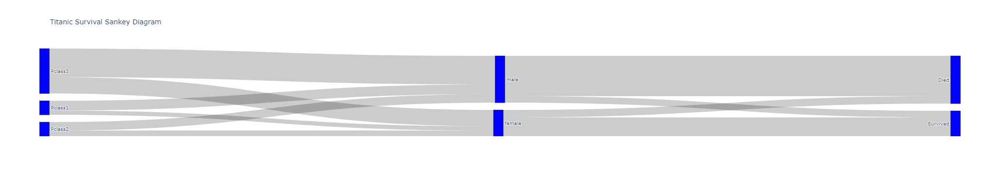

In [663]:
generate_sankey_diagram('https://raw.githubusercontent.com/plotly/datasets/master/titanic.csv')


In [664]:
df.head()

,order_id,payment_sequential,payment_type,payment_installments,payment_value,order_item_id,product_id,seller_id,shipping_limit_date,price,...,geolocation_lat_seller_zip,geolocation_lng_seller_zip,State_Seller,Region_Seller,State_Customer,Region_Customer,city_lat_seller,city_lng_seller,city_lat_customer,city_lng_customer
0,00e7ee1b050b8499577073aeb2a297a1,1.0,credit_card,2.0,146.87,1.0,a9516a079e37a9c9c36b9b78b10169e8,7c67e1448b00f6e969d365cea6b010ab,2017-05-22T15:22:12.000Z,124.99,...,-23.482623,-46.374490,Sao Paulo,Southeast,Sao Paulo,Southeast,-23.4864,-46.3486,-20.5389,-47.4008
1,29150127e6685892b6eab3eec79f59c7,1.0,credit_card,8.0,335.48,1.0,4aa6014eceb682077f9dc4bffebc05b0,b8bc237ba3788b23da09c0f1f3a3288c,2018-01-18T20:58:32.000Z,289.00,...,-26.912429,-48.677381,Santa Catarina,South,Sao Paulo,Southeast,-26.9000,-48.6667,NaN,NaN
2,b2059ed67ce144a36e2aa97d2c9e9ad2,1.0,credit_card,7.0,157.73,1.0,bd07b66896d6f1494f5b86251848ced7,7c67e1448b00f6e969d365cea6b010ab,2018-06-05T16:19:10.000Z,139.94,...,-23.482623,-46.374490,Sao Paulo,Southeast,Sao Paulo,Southeast,-23.4864,-46.3486,-23.5500,-46.6333
3,951670f92359f4fe4a63112aa7306eba,1.0,credit_card,1.0,173.30,1.0,a5647c44af977b148e0a3a4751a09e2e,7c67e1448b00f6e969d365cea6b010ab,2018-03-27T16:31:16.000Z,149.94,...,-23.482623,-46.374490,Sao Paulo,Southeast,Sao Paulo,Southeast,-23.4864,-46.3486,NaN,NaN
4,6b7d50bd145f6fc7f33cebabd7e49d0f,1.0,credit_card,8.0,252.25,1.0,9391a573abe00141c56e38d84d7d5b3b,4a3ca9315b744ce9f8e9374361493884,2018-07-31T10:10:09.000Z,230.00,...,-21.766477,-48.831547,Sao Paulo,Southeast,Sao Paulo,Southeast,-21.7578,-48.8289,-22.9058,-47.0608


In [5]:
df["payment_type"]

0         credit_card
1         credit_card
2         credit_card
3         credit_card
4         credit_card
             ...     
123010    credit_card
123011    credit_card
123012    credit_card
123013    credit_card
123014    credit_card
Name: payment_type, Length: 123015, dtype: object

In [10]:

fig = go.Figure(go.Parcats(
    dimensions=[
        {'label': "Region_Customer", 'values': df["Region_Customer"]},
        {'label': "payment_type", 'values': df["payment_type"]},
        {'label': "Region_Seller", 'values': df["Region_Seller"]},
    ],
    counts=df['count'],
))
fig.show()

KeyError: 'count'

In [9]:
categories = ["Region_Customer", "payment_type", "Region_Seller"]
newDf = pd.DataFrame()
for i in range(len(categories)-1):
    tempDf = df[[categories[i],categories[i+1],'count']]
    tempDf.columns = ['source','target','count']
    newDf = pd.concat([newDf,tempDf])    
newDf = newDf.groupby(['source','target']).agg({'count':'sum'}).reset_index()

label_list = list(np.unique(df[categories].values))
source = newDf['source'].apply(lambda x: label_list.index(x))
target = newDf['target'].apply(lambda x: label_list.index(x))
count = newDf['count']

KeyError: "['count'] not in index"

In [14]:
df.columns

Index(['order_id', 'payment_sequential', 'payment_type',
       'payment_installments', 'payment_value', 'order_item_id', 'product_id',
       'seller_id', 'shipping_limit_date', 'price', 'freight_value',
       'customer_id', 'order_status', 'order_purchase_timestamp',
       'order_approved_at', 'order_delivered_carrier_date',
       'order_delivered_customer_date', 'order_estimated_delivery_date',
       'customer_unique_id', 'customer_zip_code_prefix', 'customer_city',
       'customer_state', 'review_id', 'review_score', 'review_comment_title',
       'review_comment_message', 'review_creation_date',
       'review_answer_timestamp', 'product_category_name',
       'product_name_lenght', 'product_description_lenght',
       'product_photos_qty', 'product_weight_g', 'product_length_cm',
       'product_height_cm', 'product_width_cm',
       'product_category_name_english', 'seller_zip_code_prefix',
       'seller_city', 'seller_state', 'geolocation_lat_customer_zip',
       'geoloc

### Working Code

In [54]:
# https://stackoverflow.com/questions/70293723/how-do-i-make-a-simple-multi-level-sankey-diagram-with-plotl

In [55]:
# Three inputs
import plotly.graph_objects as go

def parallel_categories_diagram_three(df, col1, col2, col3, color = "Blues", specified_height = 600):
    # Count the number of occurrences for each combination of values in the three columns
    counts = df.groupby([col1, col2, col3]).size().reset_index(name='count')
    
    # Create the parallel categories diagram using plotly.graph_objects
    fig = go.Figure(data=[go.Parcats(
        dimensions=[{'label': col1, 'values': counts[col1]},
                    {'label': col2, 'values': counts[col2]},
                    {'label': col3, 'values': counts[col3]}],
        counts=counts['count'],
        line={'color': counts['count'], 'colorscale': color},
        arrangement='freeform')])
    
    # Update the layout of the diagram
    fig.update_layout({
        'title': {'text': 'Parallel Categories Diagram'},
        'xaxis': {'title': col1},
        'yaxis': {'title': col2},
        'height': specified_height
    })
    
    # Show the diagram
    fig.show()


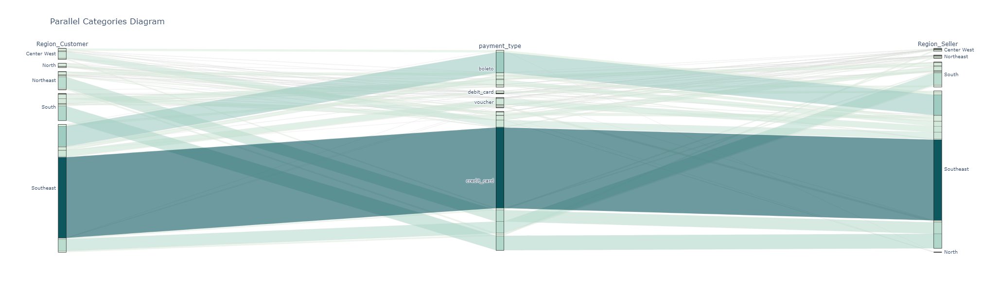

In [60]:
parallel_categories_diagram_three(df, 'Region_Customer', 'payment_type', 'Region_Seller', color = "Mint")


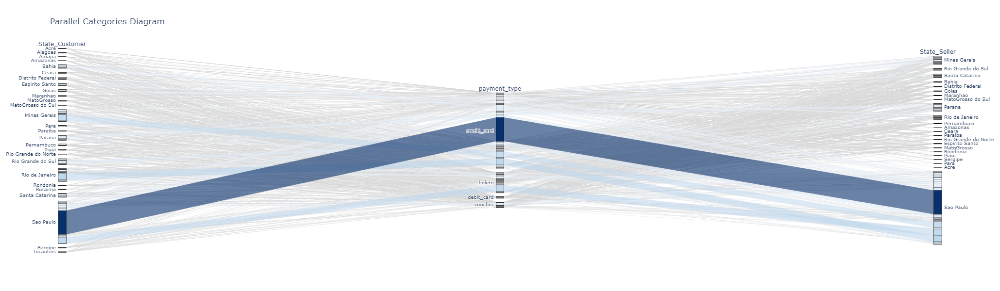

In [48]:
parallel_categories_diagram_three(df, 'State_Customer', 'payment_type', 'State_Seller')

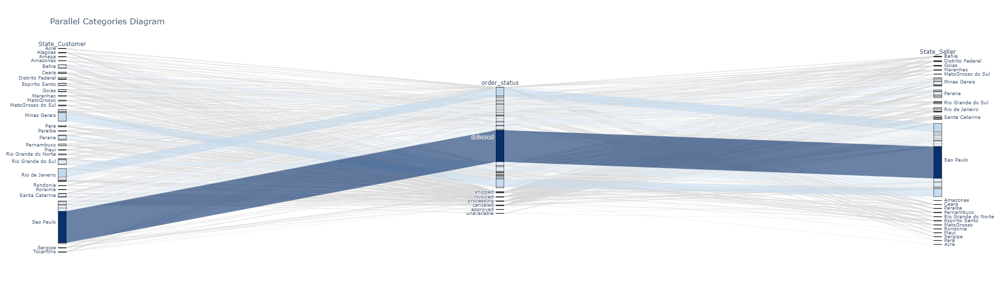

In [52]:
parallel_categories_diagram_three(df, 'State_Customer', 'order_status', 'State_Seller')

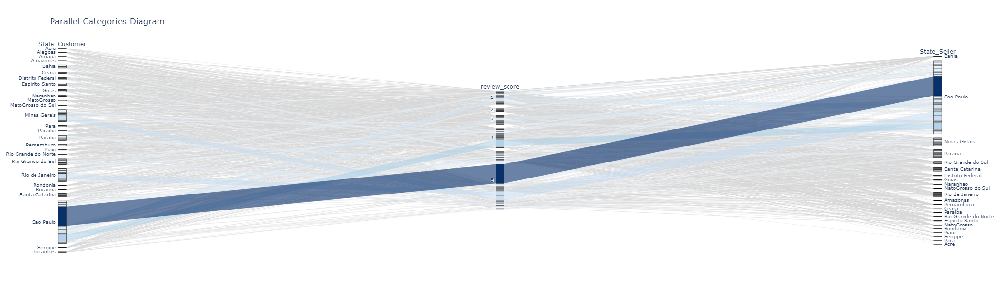

In [53]:
parallel_categories_diagram_three(df, 'State_Customer', 'review_score', 'State_Seller')

### Four Inputs

In [58]:
# Four Inputs 
import plotly.graph_objects as go

def parallel_categories_diagram_four(df, col1, col2, col3, col4, color = "Blues", specified_height = 600):
    # Count the number of occurrences for each combination of values in the four columns
    counts = df.groupby([col1, col2, col3, col4]).size().reset_index(name='count')
    
    # Create the parallel categories diagram using plotly.graph_objects
    fig = go.Figure(data=[go.Parcats(
        dimensions=[{'label': col1, 'values': counts[col1]},
                    {'label': col2, 'values': counts[col2]},
                    {'label': col3, 'values': counts[col3]},
                    {'label': col4, 'values': counts[col4]}],
        counts=counts['count'],
        line={'color': counts['count'], 'colorscale': color},
        arrangement='freeform')])
    
    # Update the layout of the diagram
    fig.update_layout({
        'title': {'text': 'Parallel Categories Diagram'},
        'xaxis': {'title': col1},
        'yaxis': {'title': col2},
        'height': specified_height
    })
    
    # Show the diagram
    fig.show()



In [40]:
#parallel_categories_diagram_four(df, 'Region_Customer', 'customer_state', 'Region_Seller', "seller_state")


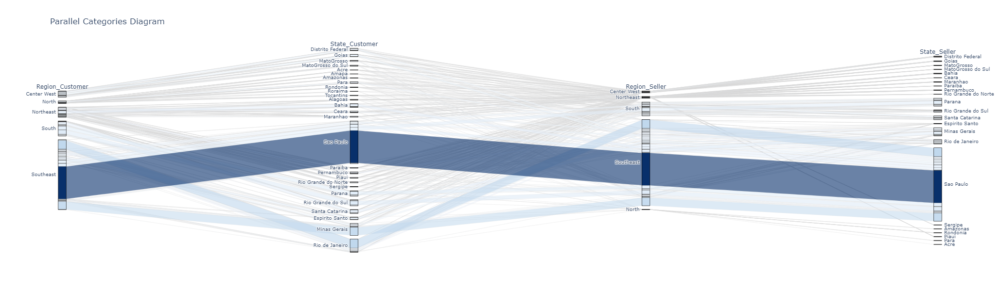

In [41]:
parallel_categories_diagram_four(df, 'Region_Customer', 'State_Customer', 'Region_Seller', "State_Seller")

In [45]:
#parallel_categories_diagram_four(df, 'Region_Customer', 'customer_city', 'Region_Seller', "seller_city", specified_height = 10000)

## Mapmaking Section

In [1]:
import folium
import pandas as pd

# create a sample dataset
data = pd.DataFrame({
   "city": ["New York", "Los Angeles", "Chicago", "Houston", "Phoenix"],
   "population": [8399000, 3990000, 2705000, 2320000, 1660000],
   "longitude": [-74.0060, -118.2437, -87.6298, -95.3698, -112.0740],
   "latitude": [40.7128, 34.0522, 41.8781, 29.7604, 33.4484]
})

# create the base map
m = folium.Map(location=[39.8283, -98.5795], zoom_start=4)

# add the bubbles to the map
for i, row in data.iterrows():
    folium.Marker([row['latitude'], row['longitude']], popup=row['city']).add_to(m)
    folium.CircleMarker([row['latitude'], row['longitude']], radius=row['population']/100000, color='red', fill=True, fill_color='red', fill_opacity=0.5).add_to(m)

# show the map
m


In [68]:
import folium

def create_bubble_map(df, lat_col, lon_col, popup_col, radius_col):
    # center the map on Brazil
    m = folium.Map(location=[-14.2350, -51.9253], zoom_start=4)

    # add the bubbles to the map
    for i, row in df.iterrows():
        folium.Marker([row[lat_col], row[lon_col]], popup=row[popup_col]).add_to(m)
        folium.CircleMarker([row[lat_col], row[lon_col]], radius=row[radius_col]/100000, color='red', fill=True, fill_color='red', fill_opacity=0.5).add_to(m)

    # show the map
    return m


In [3]:
import folium

def create_bubble_map(df, lat_col, lon_col, popup_col, radius_col):
    # center the map on Brazil
    m = folium.Map(location=[-14.2350, -51.9253], zoom_start=4)

    # add the bubbles to the map
    for i, row in df.iterrows():
        if pd.notnull(row[lat_col]) and pd.notnull(row[lon_col]):
            folium.Marker([row[lat_col], row[lon_col]], popup=row[popup_col]).add_to(m)
            folium.CircleMarker([row[lat_col], row[lon_col]], radius=row[radius_col]/100000, color='red', fill=True, fill_color='red', fill_opacity=0.5).add_to(m)

    # show the map
    return m


In [5]:
import folium

def create_bubble_map(df, lat_col, lon_col, popup_col, radius_col):
    # drop rows with null latitude or longitude values
    df = df.dropna(subset=[lat_col, lon_col])
    
    # center the map on Brazil
    m = folium.Map(location=[-14.2350, -51.9253], zoom_start=4)

    # add the bubbles to the map
    for i, row in df.iterrows():
        folium.Marker([row[lat_col], row[lon_col]], popup=row[popup_col]).add_to(m)
        folium.CircleMarker([row[lat_col], row[lon_col]], radius=row[radius_col]/100000, color='red', fill=True, fill_color='red', fill_opacity=0.5).add_to(m)

    # show the map
    return m


In [ ]:
create_bubble_map(df, 'city_lat_customer', 'city_lng_customer', 'customer_city','payment_value')

In [69]:
df.columns

Index(['order_id', 'payment_sequential', 'payment_type',
       'payment_installments', 'payment_value', 'order_item_id', 'product_id',
       'seller_id', 'shipping_limit_date', 'price', 'freight_value',
       'customer_id', 'order_status', 'order_purchase_timestamp',
       'order_approved_at', 'order_delivered_carrier_date',
       'order_delivered_customer_date', 'order_estimated_delivery_date',
       'customer_unique_id', 'customer_zip_code_prefix', 'customer_city',
       'customer_state', 'review_id', 'review_score', 'review_comment_title',
       'review_comment_message', 'review_creation_date',
       'review_answer_timestamp', 'product_category_name',
       'product_name_lenght', 'product_description_lenght',
       'product_photos_qty', 'product_weight_g', 'product_length_cm',
       'product_height_cm', 'product_width_cm',
       'product_category_name_english', 'seller_zip_code_prefix',
       'seller_city', 'seller_state', 'geolocation_lat_customer_zip',
       'geoloc

In [6]:
# Somewhat workable
import folium
import pandas as pd

def create_bubble_map(df, lat_col, lon_col, popup_col, radius_col):
    # drop rows with null latitude or longitude values
    df = df.dropna(subset=[lat_col, lon_col])

    # group data by latitude and longitude
    grouped = df.groupby([lat_col, lon_col], as_index=False)

    # calculate aggregate values for each group
    aggregated = grouped.agg({popup_col: lambda x: "<br>".join(x), radius_col: 'sum'})

    # center the map on Brazil
    m = folium.Map(location=[-14.2350, -51.9253], zoom_start=4)

    # add the bubbles to the map
    for i, row in aggregated.iterrows():
        folium.Marker([row[lat_col], row[lon_col]], popup=row[popup_col]).add_to(m)
        folium.CircleMarker([row[lat_col], row[lon_col]], radius=row[radius_col]/100000, color='red', fill=True, fill_color='red', fill_opacity=0.5).add_to(m)

    # show the map
    return m


In [5]:
create_bubble_map(df, 'city_lat_customer', 'city_lng_customer', 'customer_city','payment_value')

## Very Good Stuff

In [27]:
# Better implementation

import folium
import pandas as pd

def create_bubble_map(df, lat_col, lon_col, popup_col, radius_col):
    # drop rows with null latitude or longitude values
    df = df.dropna(subset=[lat_col, lon_col])

    # group data by popup column
    grouped = df.groupby(popup_col, as_index=False)

    # calculate sum of radius for each group
    aggregated = grouped.agg({lat_col: 'mean', lon_col: 'mean', radius_col: 'sum'})

    # center the map on Brazil
    m = folium.Map(location=[-14.2350, -51.9253], zoom_start=4)

    # add circle markers to the map for each group
    for i, row in aggregated.iterrows():
        folium.CircleMarker([row[lat_col], row[lon_col]], radius=row[radius_col]/100000, color='red', fill=True, fill_color='red', fill_opacity=0.5, popup=row[popup_col]).add_to(m)

    # show the map
    return m


In [28]:
create_bubble_map(df, 'city_lat_customer', 'city_lng_customer', 'customer_city','payment_value')

In [18]:
create_bubble_map(df, 'city_lat_seller', 'city_lng_seller', 'seller_city','payment_value')

In [12]:
create_bubble_map(df, 'geolocation_lat_customer_zip', 'geolocation_lng_customer_zip', 'customer_city','payment_value')

In [15]:
# Not going to use
import folium
import pandas as pd
from branca.colormap import linear

def create_bubble_map(df, lat_col, lon_col, popup_col, radius_col):
    # drop rows with null latitude or longitude values
    df = df.dropna(subset=[lat_col, lon_col])

    # group data by popup column
    grouped = df.groupby(popup_col, as_index=False)

    # calculate sum of radius for each group
    aggregated = grouped.agg({lat_col: 'mean', lon_col: 'mean', radius_col: 'sum'})

    # create colormap based on radius_col values
    colormap = linear.RdYlBu_06.scale(aggregated[radius_col].min(), aggregated[radius_col].max())

    # center the map on Brazil
    m = folium.Map(location=[-14.2350, -51.9253], zoom_start=4)

    # add circle markers to the map for each group
    for i, row in aggregated.iterrows():
        color = colormap(row[radius_col])
        folium.CircleMarker([row[lat_col], row[lon_col]], radius=row[radius_col]/100000, color=None, fill=True, fill_color=color, fill_opacity=0.5, popup=row[popup_col]).add_to(m)

    # show the map
    return m


In [14]:
create_bubble_map(df, 'city_lat_customer', 'city_lng_customer', 'customer_city','payment_value')

In [29]:
# Working Code In Plotly 
# Parallel Categories Diagram 
def parallel_categories_diagram_three(df, col1, col2, col3, color = "Blues", specified_height = 600):
    # Count the number of occurrences for each combination of values in the three columns
    counts = df.groupby([col1, col2, col3]).size().reset_index(name='count')
    
    # Create the parallel categories diagram using plotly.graph_objects
    fig = go.Figure(data=[go.Parcats(
        dimensions=[{'label': col1, 'values': counts[col1]},
                    {'label': col2, 'values': counts[col2]},
                    {'label': col3, 'values': counts[col3]}],
        counts=counts['count'],
        line={'color': counts['count'], 'colorscale': color},
        arrangement='freeform')])
    
    # Update the layout of the diagram
    
    fig.update_layout(
        margin=dict(l=20, r=20, t=20, b=20),
        paper_bgcolor="Black",
        )
    
    
    fig.update_layout({
        'xaxis': {'title': col1},
        'yaxis': {'title': col2},
        'height': specified_height,
        "width": 1200
    })
    
    #'title': {'text': 'Parallel Categories Diagram'},
   
    # Show the diagram
    fig.show()
    #return st.plotly_chart(fig)


In [8]:
df.columns

Index(['order_id', 'payment_sequential', 'payment_type',
       'payment_installments', 'payment_value', 'order_item_id', 'product_id',
       'seller_id', 'shipping_limit_date', 'price', 'freight_value',
       'customer_id', 'order_status', 'order_purchase_timestamp',
       'order_approved_at', 'order_delivered_carrier_date',
       'order_delivered_customer_date', 'order_estimated_delivery_date',
       'customer_unique_id', 'customer_zip_code_prefix', 'customer_city',
       'customer_state', 'review_id', 'review_score', 'review_comment_title',
       'review_comment_message', 'review_creation_date',
       'review_answer_timestamp', 'product_category_name',
       'product_name_lenght', 'product_description_lenght',
       'product_photos_qty', 'product_weight_g', 'product_length_cm',
       'product_height_cm', 'product_width_cm',
       'product_category_name_english', 'seller_zip_code_prefix',
       'seller_city', 'seller_state', 'geolocation_lat_customer_zip',
       'geoloc

In [13]:
def scatterplot_with_line_of_best_fit(df, x_col, y_col):
    fig = px.scatter(df, x = x_col, y = y_col, trendline = "ols")

    fig.show()

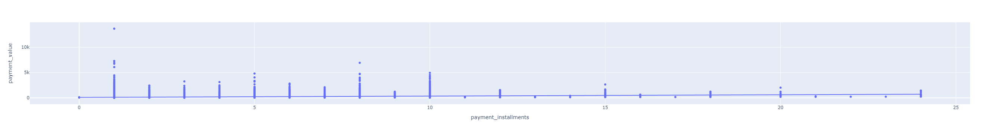

In [14]:
scatterplot_with_line_of_best_fit(df, "payment_installments", "payment_value")

In [22]:
df.columns

Index(['order_id', 'payment_sequential', 'payment_type',
       'payment_installments', 'payment_value', 'order_item_id', 'product_id',
       'seller_id', 'shipping_limit_date', 'price', 'freight_value',
       'customer_id', 'order_status', 'order_purchase_timestamp',
       'order_approved_at', 'order_delivered_carrier_date',
       'order_delivered_customer_date', 'order_estimated_delivery_date',
       'customer_unique_id', 'customer_zip_code_prefix', 'customer_city',
       'customer_state', 'review_id', 'review_score', 'review_comment_title',
       'review_comment_message', 'review_creation_date',
       'review_answer_timestamp', 'product_category_name',
       'product_name_lenght', 'product_description_lenght',
       'product_photos_qty', 'product_weight_g', 'product_length_cm',
       'product_height_cm', 'product_width_cm',
       'product_category_name_english', 'seller_zip_code_prefix',
       'seller_city', 'seller_state', 'geolocation_lat_customer_zip',
       'geoloc

In [26]:
type(df["order_purchase_timestamp"][0])

str

In [27]:
# Auto convert datetime columns by iterating through them 
for col in df.columns:
    if df[col].dtype == 'object':
        try:
            df[col] = pd.to_datetime(df[col])
        except ValueError:
            pass


In [28]:
df["order_purchase_timestamp"].dt.hour

0         15
1         20
2         16
3         16
4          9
          ..
123010    15
123011     8
123012    20
123013    21
123014    14
Name: order_purchase_timestamp, Length: 123015, dtype: int64

In [29]:
df["customer_city"]

0                        Franca
1         Sao Bernardo Do Campo
2                     Sao Paulo
3               Mogi Das Cruzes
4                      Campinas
                  ...          
123010                Sao Paulo
123011          Taboao Da Serra
123012                Fortaleza
123013                   Canoas
123014                    Cotia
Name: customer_city, Length: 123015, dtype: object

In [31]:
df["review_score"]

0         4.0
1         5.0
2         5.0
3         5.0
4         5.0
         ... 
123010    4.0
123011    5.0
123012    1.0
123013    5.0
123014    5.0
Name: review_score, Length: 123015, dtype: float64

In [33]:
type(df["payment_value"][0])

numpy.float64

In [37]:
type(df["product_category_name_english"][0])

str

In [5]:
#pd.set_option("display.max_rows", None)
pd.reset_option('all')
print(df["product_category_name_english"].value_counts())

C:\Users\AlonzoRoberts\AppData\Local\Temp\ipykernel_25240\1093686979.py:2: FutureWarning: column_space is deprecated and will be removed in a future version. Use df.to_string(col_space=...) instead.
  pd.reset_option('all')
C:\Users\AlonzoRoberts\AppData\Local\Temp\ipykernel_25240\1093686979.py:2: FutureWarning: As the xlwt package is no longer maintained, the xlwt engine will be removed in a future version of pandas. This is the only engine in pandas that supports writing in the xls format. Install openpyxl and write to an xlsx file instead.
  pd.reset_option('all')
C:\Users\AlonzoRoberts\AppData\Local\Temp\ipykernel_25240\1093686979.py:2: FutureWarning: 
: boolean
    use_inf_as_null had been deprecated and will be removed in a future
    version. Use `use_inf_as_na` instead.

  pd.reset_option('all')


bed_bath_table               12315
health_beauty                10436
sports_leisure                9387
furniture_decor               9135
computers_accessories         8464
                             ...  
arts_and_craftmanship           25
la_cuisine                      16
cds_dvds_musicals               14
fashion_childrens_clothes        8
security_and_services            2
Name: product_category_name_english, Length: 71, dtype: int64


In [6]:
df["product_category_name_english"]

0               office_furniture
1                     housewares
2               office_furniture
3               office_furniture
4                   home_confort
                   ...          
123010    books_general_interest
123011            sports_leisure
123012             health_beauty
123013             watches_gifts
123014                 perfumery
Name: product_category_name_english, Length: 123015, dtype: object

In [8]:
df["product_category_name"]

0              moveis_escritorio
1          utilidades_domesticas
2              moveis_escritorio
3              moveis_escritorio
4                  casa_conforto
                   ...          
123010    livros_interesse_geral
123011             esporte_lazer
123012              beleza_saude
123013        relogios_presentes
123014                perfumaria
Name: product_category_name, Length: 123015, dtype: object

In [11]:
df["product_category_name_english"].astype(str)

0               office_furniture
1                     housewares
2               office_furniture
3               office_furniture
4                   home_confort
                   ...          
123010    books_general_interest
123011            sports_leisure
123012             health_beauty
123013             watches_gifts
123014                 perfumery
Name: product_category_name_english, Length: 123015, dtype: object

In [12]:
df["customer_city"]

0                        Franca
1         Sao Bernardo Do Campo
2                     Sao Paulo
3               Mogi Das Cruzes
4                      Campinas
                  ...          
123010                Sao Paulo
123011          Taboao Da Serra
123012                Fortaleza
123013                   Canoas
123014                    Cotia
Name: customer_city, Length: 123015, dtype: object

In [14]:
df.columns

Index(['order_id', 'payment_sequential', 'payment_type',
       'payment_installments', 'payment_value', 'order_item_id', 'product_id',
       'seller_id', 'shipping_limit_date', 'price', 'freight_value',
       'customer_id', 'order_status', 'order_purchase_timestamp',
       'order_approved_at', 'order_delivered_carrier_date',
       'order_delivered_customer_date', 'order_estimated_delivery_date',
       'customer_unique_id', 'customer_zip_code_prefix', 'customer_city',
       'customer_state', 'review_id', 'review_score', 'review_comment_title',
       'review_comment_message', 'review_creation_date',
       'review_answer_timestamp', 'product_category_name',
       'product_name_lenght', 'product_description_lenght',
       'product_photos_qty', 'product_weight_g', 'product_length_cm',
       'product_height_cm', 'product_width_cm',
       'product_category_name_english', 'seller_zip_code_prefix',
       'seller_city', 'seller_state', 'geolocation_lat_customer_zip',
       'geoloc

In [15]:
df["order_status"]

0         delivered
1         delivered
2         delivered
3         delivered
4         delivered
            ...    
123010    delivered
123011    delivered
123012    delivered
123013    delivered
123014    delivered
Name: order_status, Length: 123015, dtype: object

In [22]:
df.loc[df["customer_city"] == "Sao Vicente"]["Region_Customer"].value_counts()

Southeast    194
Northeast      2
Name: Region_Customer, dtype: int64

In [29]:
df.loc[df["customer_city"] == "Sao Vicente"]["State_Customer"].value_counts()

Sao Paulo              194
Rio Grande do Norte      2
Name: State_Customer, dtype: int64

In [23]:
df.loc[df["customer_city"] == "Sao Vicente"].loc[df["Region_Customer"] == "Northeast"]

,order_id,payment_sequential,payment_type,payment_installments,payment_value,order_item_id,product_id,seller_id,shipping_limit_date,price,...,geolocation_lat_seller_zip,geolocation_lng_seller_zip,State_Seller,Region_Seller,State_Customer,Region_Customer,city_lat_seller,city_lng_seller,city_lat_customer,city_lng_customer
29500,efdaf1dc3d38b68061394b681ca45ff8,1.0,credit_card,3.0,169.84,1.0,ba9f160a6ae1c23f25d690fd06fe4fd8,ac3508719a1d8f5b7614b798f70af136,2017-07-27T18:45:15.000Z,109.90,...,-29.914669,-51.148441,Rio Grande do Sul,South,Rio Grande do Norte,Northeast,-29.9200,-51.1800,-23.9633,-46.3922
103646,21adb757aaef1f7f6240352b33d30e5a,1.0,boleto,1.0,206.57,1.0,d8d04b94572126180be57d08fddb186a,7c67e1448b00f6e969d365cea6b010ab,2018-04-18T03:09:03.000Z,154.99,...,-23.482623,-46.374490,Sao Paulo,Southeast,Rio Grande do Norte,Northeast,-23.4864,-46.3486,-23.9633,-46.3922


In [24]:
df.loc[df["customer_city"] == "Antonio Carlos"]["Region_Customer"].value_counts()

South        3
Southeast    1
Name: Region_Customer, dtype: int64

In [30]:
df.loc[df["customer_city"] == "Antonio Carlos"]["State_Customer"].value_counts()

Santa Catarina    3
Minas Gerais      1
Name: State_Customer, dtype: int64

In [25]:
df.loc[df["customer_city"] == "Antonio Carlos"]

,order_id,payment_sequential,payment_type,payment_installments,payment_value,order_item_id,product_id,seller_id,shipping_limit_date,price,...,geolocation_lat_seller_zip,geolocation_lng_seller_zip,State_Seller,Region_Seller,State_Customer,Region_Customer,city_lat_seller,city_lng_seller,city_lat_customer,city_lng_customer
3236,01882618ede11253381513166b49429e,1.0,credit_card,1.0,48.21,1.0,50d77758742285ff49f340ebdf0df5a7,d91fb3b7d041e83b64a00a3edfb37e4f,2018-06-28T11:58:10.000Z,29.9,...,-24.026787,-46.493049,Sao Paulo,Southeast,Minas Gerais,Southeast,-24.0061,-46.4028,-21.3178,-43.7469
6209,d1846813d43b3ddbf1b6394b223a4d6c,2.0,voucher,1.0,100.00,1.0,83f2c628d86dde5369cde6ffb51d919a,6d66611d7c44cc30ce351abc49a68421,2017-08-03T09:45:09.000Z,85.9,...,-23.646246,-46.663499,Sao Paulo,Southeast,Santa Catarina,South,-23.5500,-46.6333,-21.3178,-43.7469
6210,d1846813d43b3ddbf1b6394b223a4d6c,1.0,credit_card,1.0,1.26,1.0,83f2c628d86dde5369cde6ffb51d919a,6d66611d7c44cc30ce351abc49a68421,2017-08-03T09:45:09.000Z,85.9,...,-23.646246,-46.663499,Sao Paulo,Southeast,Santa Catarina,South,-23.5500,-46.6333,-21.3178,-43.7469
121419,e50d7ddc8da687eef58e56ea9444d302,1.0,boleto,1.0,144.68,1.0,a38b238734207eeb0388676235cf56ec,86ccac0b835037332a596a33b6949ee1,2017-05-15T09:35:22.000Z,129.9,...,-26.911411,-49.111436,Santa Catarina,South,Santa Catarina,South,-26.9333,-49.0500,-21.3178,-43.7469
